# Lab 3: Generating Data

Based on assignments by Lisa Zhang and Jimmy Ba.

In this lab, you will build models to perform image colourization. That is, given a greyscale image, we wish to predict the colour at each pixel. Image colourization is a difficult problem for many reasons, one of which being that it is ill-posed: for a single greyscale image, there can be multiple, equally valid colourings.

To keep the training time manageable we will use the CIFAR-10 data set, which consists of images of size 32x32 pixels. For most of the questions we will use a subset of the dataset. The data loading script is included with the notebooks, and should download automatically the first time it is loaded. 

We will be starting with a convolutional autoencoder and tweaking it along the way to improve our perforamnce. Then as a second part of the assignment we will compare the autoencoder approach to conditional generative adversarial networks (cGANs).

In the process, you are expected to learn to:

1. Clean and process the dataset and create greyscale images.
2. Implement and modify an autoencoder architecture.
3. Tune the hyperparameters of an autoencoder.
4. Implement skip connections and other techniques to improve performance.
5. Implement a cGAN and compare with an autoencoder.
6. Improve on the cGAN by trying one of several techniques to enhance training.


### What to submit

Submit an HTML file containing all your code, outputs, and write-up
from parts A and B. You can produce a HTML file directly from Google Colab. The Colab instructions are provided at the end of this document.

**Do not submit any other files produced by your code.**

Include a link to your colab file in your submission.

Please use Google Colab to complete this assignment. If you want to use Jupyter Notebook, please complete the assignment and upload your Jupyter Notebook file to Google Colab for submission. 

## Colab Link

Include a link to your Colab file here. If you would like the TA to look at your
Colab file in case your solutions are cut off, **please make sure that your Colab
file is publicly accessible at the time of submission**.

Colab Link: https://colab.research.google.com/drive/16C0QY59MiE-7bwwrEl5A4_QA3XE45-YD#scrollTo=fFMdtipUPNdu

Student ID: 1009176204

# PART A - Autoencoder [20 pt]

In this part we will construct and compare different autoencoder models for the image colourization task.

#### Helper code

Provided are some helper functions for loading and preparing the data. Note that you will need to use the Colab GPU for this assignment.

In [ ]:
"""
Colourization of CIFAR-10 Horses via classification.
"""
import argparse
import math
import time

import matplotlib
import matplotlib.pyplot as plt
import numpy as np
import numpy.random as npr
import scipy.misc
import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.autograd import Variable


In [ ]:
######################################################################
# Setup working directory
######################################################################
%mkdir -p /content/a3/
%cd /content/a3


/content/a3


In [ ]:
######################################################################
# Helper functions for loading data
######################################################################
# adapted from
# https://github.com/fchollet/keras/blob/master/keras/datasets/cifar10.py

import os
import pickle
import sys
import tarfile

import numpy as np
from PIL import Image
from six.moves.urllib.request import urlretrieve


def get_file(fname, origin, untar=False, extract=False, archive_format="auto", cache_dir="data"):
    datadir = os.path.join(cache_dir)
    if not os.path.exists(datadir):
        os.makedirs(datadir)

    if untar:
        untar_fpath = os.path.join(datadir, fname)
        fpath = untar_fpath + ".tar.gz"
    else:
        fpath = os.path.join(datadir, fname)

    print("File path: %s" % fpath)
    if not os.path.exists(fpath):
        print("Downloading data from", origin)

        error_msg = "URL fetch failure on {}: {} -- {}"
        try:
            try:
                urlretrieve(origin, fpath)
            except URLError as e:
                raise Exception(error_msg.format(origin, e.errno, e.reason))
            except HTTPError as e:
                raise Exception(error_msg.format(origin, e.code, e.msg))
        except (Exception, KeyboardInterrupt) as e:
            if os.path.exists(fpath):
                os.remove(fpath)
            raise

    if untar:
        if not os.path.exists(untar_fpath):
            print("Extracting file.")
            with tarfile.open(fpath) as archive:
                archive.extractall(datadir)
        return untar_fpath

    if extract:
        _extract_archive(fpath, datadir, archive_format)

    return fpath


def load_batch(fpath, label_key="labels"):
    """Internal utility for parsing CIFAR data.
    # Arguments
        fpath: path the file to parse.
        label_key: key for label data in the retrieve
            dictionary.
    # Returns
        A tuple `(data, labels)`.
    """
    f = open(fpath, "rb")
    if sys.version_info < (3,):
        d = pickle.load(f)
    else:
        d = pickle.load(f, encoding="bytes")
        # decode utf8
        d_decoded = {}
        for k, v in d.items():
            d_decoded[k.decode("utf8")] = v
        d = d_decoded
    f.close()
    data = d["data"]
    labels = d[label_key]

    data = data.reshape(data.shape[0], 3, 32, 32)
    return data, labels


def load_cifar10(transpose=False):
    """Loads CIFAR10 dataset.
    # Returns
        Tuple of Numpy arrays: `(x_train, y_train), (x_test, y_test)`.
    """
    dirname = "cifar-10-batches-py"
    origin = "http://www.cs.toronto.edu/~kriz/cifar-10-python.tar.gz"
    path = get_file(dirname, origin=origin, untar=True)

    num_train_samples = 50000

    x_train = np.zeros((num_train_samples, 3, 32, 32), dtype="uint8")
    y_train = np.zeros((num_train_samples,), dtype="uint8")

    for i in range(1, 6):
        fpath = os.path.join(path, "data_batch_" + str(i))
        data, labels = load_batch(fpath)
        x_train[(i - 1) * 10000 : i * 10000, :, :, :] = data
        y_train[(i - 1) * 10000 : i * 10000] = labels

    fpath = os.path.join(path, "test_batch")
    x_test, y_test = load_batch(fpath)

    y_train = np.reshape(y_train, (len(y_train), 1))
    y_test = np.reshape(y_test, (len(y_test), 1))

    if transpose:
        x_train = x_train.transpose(0, 2, 3, 1)
        x_test = x_test.transpose(0, 2, 3, 1)
    return (x_train, y_train), (x_test, y_test)

In [ ]:
# Download CIFAR dataset
m = load_cifar10()

File path: data/cifar-10-batches-py.tar.gz
Extracting file.


## Part 1. Data Preparation [7 pt]

To start off run the above code to load the CIFAR dataset and then work through the following questions/tasks. 

### Part (a) [1pt]
Verify that the dataset has loaded correctly. How many samples do we have? How is the data organized?

In [ ]:
# code to examine the dataset
train_data, test_data=m

In [ ]:
x_train, y_train= train_data

In [ ]:
x_test, y_test= test_data

In [ ]:
print(x_train.shape)
print(y_train.shape)

(50000, 3, 32, 32)
(50000, 1)


In [ ]:
print(x_test.shape)
print(y_test.shape)

(10000, 3, 32, 32)
(10000, 1)


**Answer:**
- We have 50,000 samples in the train set and 10,000 samples in the test set. 
- x_train and x_test have 32*32 RGB images. 
- The y_train and y_test have the labels which denote the class the image belongs to.

### Part (b) [2pt]
Preprocess the data to select only images of horses. Learning to generate only hourse images will make our task easier. Your function will also convert the colour images to greyscale to create our input data.

In [ ]:
# select a single category.
HORSE_CATEGORY = 7

# convert colour images into greyscale
def process(xs, ys, max_pixel=256.0, downsize_input=False):
    """
    Pre-process CIFAR10 images by taking only the horse category,
    shuffling, and have colour values be bound between 0 and 1

    Args:
      xs: the colour RGB pixel values
      ys: the category labels
      max_pixel: maximum pixel value in the original data
    Returns:
      xs: value normalized and shuffled colour images
      grey: greyscale images, also normalized so values are between 0 and 1
    """
    xs = xs / max_pixel
    xs = xs[np.where(ys == HORSE_CATEGORY)[0], :, :, :]
    npr.shuffle(xs)

    grey = np.mean(xs, axis=1, keepdims=True)

    if downsize_input:
        downsize_module = nn.Sequential(
            nn.AvgPool2d(2),
            nn.AvgPool2d(2),
            nn.Upsample(scale_factor=2),
            nn.Upsample(scale_factor=2),
        )
        xs_downsized = downsize_module.forward(torch.from_numpy(xs).float())
        xs_downsized = xs_downsized.data.numpy()
        return (xs, xs_downsized)
    else:
        return (xs, grey)


In [ ]:
x_train_RGB_shuffled, x_train_grey= process(x_train, y_train)

In [ ]:
x_test_RGB_shuffled, x_test_grey= process(x_test, y_test)

In [ ]:
print(x_train_grey.shape)
print(x_test_grey.shape)

(5000, 1, 32, 32)
(1000, 1, 32, 32)


**Answer:**
We have 5000 greyscale horse images in the train set and 1000 greyscale horse images in the test set. We know it is greyscale now sine we have only 1 output channel for each sample image.

### Part (c) [2pt]
Create a dataloader (or function) to batch the samples.

In [ ]:
# dataloader for batching samples

def get_batch(x, y, batch_size):
    """
    Generated that yields batches of data

    Args:
      x: input values
      y: output values
      batch_size: size of each batch
    Yields:
      batch_x: a batch of inputs of size at most batch_size
      batch_y: a batch of outputs of size at most batch_size
    """
    N = np.shape(x)[0]
    assert N == np.shape(y)[0]
    for i in range(0, N, batch_size):
        batch_x = x[i : i + batch_size, :, :, :]
        batch_y = y[i : i + batch_size, :, :, :]
        yield (batch_x, batch_y)

In [ ]:
x_test_grey.shape

(1000, 1, 32, 32)

In [ ]:
x_train_batch, y_train_batch= next(iter(get_batch(x_train_grey, x_train_RGB_shuffled, 100)))

In [ ]:
x_test_batch, y_test_batch= next(iter(get_batch(x_test_grey, x_test_RGB_shuffled, 100)))

In [ ]:
print(x_train_batch.shape, y_train_batch.shape)

(100, 1, 32, 32) (100, 3, 32, 32)


In [ ]:
print(x_test_batch.shape, y_test_batch.shape)

(100, 1, 32, 32) (100, 3, 32, 32)


### Part (e) [2pt]
Verify and visualize that we are able to generate different batches of data.

In [ ]:
# code to load different batches of horse dataset

print("Loading data...")
(x_train, y_train), (x_test, y_test) = load_cifar10()

print("Transforming data...")
train_rgb, train_grey = process(x_train, y_train)
test_rgb, test_grey = process(x_test, y_test)


Loading data...
File path: data/cifar-10-batches-py.tar.gz
Transforming data...


In [ ]:
# shape of data and labels before selection
print(x_train.shape, y_train.shape)

(50000, 3, 32, 32) (50000, 1)


In [ ]:
# shape of training data
print('Training Data: ', train_rgb.shape, train_grey.shape)
# shape of testing data
print('Testing Data: ', test_rgb.shape, test_grey.shape)

Training Data:  (5000, 3, 32, 32) (5000, 1, 32, 32)
Testing Data:  (1000, 3, 32, 32) (1000, 1, 32, 32)


Load Batches

In [ ]:
# obtain batches of images
xs, ys = next(iter(get_batch(train_grey, train_rgb, 10)))
print(xs.shape, ys.shape)

(10, 1, 32, 32) (10, 3, 32, 32)


Visualization

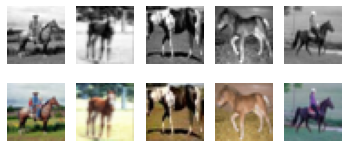

In [ ]:
# obtain one batch of train images

xs_train, ys_train = next(iter(get_batch(train_grey, train_rgb, 5))) # We get first 5 images in test set

# Converting numpy arrays torch tensors
xs_grey = torch.from_numpy(xs_train).float() #NCHW
ys_rgb = torch.from_numpy(ys_train).float()


#correct image structure
xs_grey = np.transpose(xs_grey[:5, :, :, :], [0, 2, 3, 1]).squeeze()  # Get the first 5 tensors
ys_rgb = np.transpose(ys_rgb[:5, :, :, :], [0, 2, 3, 1])   # Get the first 5 tensors

for i in range(5):
    ax = plt.subplot(3, 5, i + 1)
    ax.imshow(xs_grey[i], cmap='gray')
    ax.axis("off")
    ax = plt.subplot(3, 5, i + 1 + 5)
    ax.imshow(ys_rgb[i])
    ax.axis("off")
plt.show()

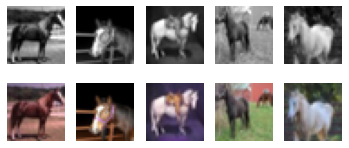

In [ ]:
# obtain one batch of test images

xs_test, ys_test = next(iter(get_batch(test_grey, test_rgb, 5))) # We get first 5 images in test set

xs_grey = torch.from_numpy(xs_test).float()
ys_rgb = torch.from_numpy(ys_test).float()


#correct image structure
xs_grey = np.transpose(xs_grey[:5, :, :, :], [0, 2, 3, 1]).squeeze()
ys_rgb = np.transpose(ys_rgb[:5, :, :, :], [0, 2, 3, 1])

for i in range(5):
    ax = plt.subplot(3, 5, i + 1)
    ax.imshow(xs_grey[i], cmap='gray')
    ax.axis("off")
    ax = plt.subplot(3, 5, i + 1 + 5) # Positions the rgb image after moving 5 indexs so that it is positioned right at the bottom
    ax.imshow(ys_rgb[i])
    ax.axis("off")
plt.show()

## Part 2. Colourization as Regression [5 pt]

There are many ways to frame the problem of image colourization as a machine learning problem. One naive approach is to frame it as a regression problem, where we build a model to predict the RGB intensities at each pixel given the greyscale input. In this case, the outputs are continuous, and so squared error can be used to train the model.

In this section, you will get familar with training neural networks using cloud GPUs. Run the helper code and answer the questions that follow.

#### Helper Code

Regression Architecture

In [ ]:
class RegressionCNN(nn.Module):
    def __init__(self, kernel, num_filters):
        # first call parent's initialization function
        super().__init__()
        padding = kernel // 2  #floored division

        self.downconv1 = nn.Sequential(
            nn.Conv2d(1, num_filters, kernel_size=kernel, padding=padding),
            nn.BatchNorm2d(num_filters),  # shape remains the same
            nn.ReLU(),
            nn.MaxPool2d(2),)
        self.downconv2 = nn.Sequential(
            nn.Conv2d(num_filters, num_filters*2, kernel_size=kernel, padding=padding),
            nn.BatchNorm2d(num_filters*2),
            nn.ReLU(),
            nn.MaxPool2d(2),)

        self.rfconv = nn.Sequential(
            nn.Conv2d(num_filters*2, num_filters*2, kernel_size=kernel, padding=padding),
            nn.BatchNorm2d(num_filters*2),
            nn.ReLU())

        self.upconv1 = nn.Sequential(
            nn.Conv2d(num_filters*2, num_filters, kernel_size=kernel, padding=padding),
            nn.BatchNorm2d(num_filters),
            nn.ReLU(),
            nn.Upsample(scale_factor=2),)
        self.upconv2 = nn.Sequential(
            nn.Conv2d(num_filters, 3, kernel_size=kernel, padding=padding),
            nn.BatchNorm2d(3),
            nn.ReLU(),
            nn.Upsample(scale_factor=2),)
        self.finalconv = nn.Conv2d(3, 3, kernel_size=kernel, padding=padding)

    def forward(self, x):
        out = self.downconv1(x)
        out = self.downconv2(out)
        out = self.rfconv(out)
        out = self.upconv1(out)
        out = self.upconv2(out)
        out = self.finalconv(out)
        return out

Training code

In [ ]:
# Creating a new name to save overfit models
def get_model_name(name, batch_size, learning_rate, epoch):
  
    path = "Saved_model_{0}_bs{1}_lr{2}_epoch{3}".format(name,
                                                   batch_size,
                                                   learning_rate,
                                                   epoch)
    return path


In [ ]:
class AttrDict(dict):
    def __init__(self, *args, **kwargs):
        super(AttrDict, self).__init__(*args, **kwargs)
        self.__dict__ = self

def get_torch_vars(xs, ys, gpu=False):
    """
    Helper function to convert numpy arrays to pytorch tensors.
    If GPU is used, move the tensors to GPU.

    Args:
      xs (float numpy tenosor): greyscale input
      ys (int numpy tenosor): rgb as labels
      gpu (bool): whether to move pytorch tensor to GPU
    Returns:
      Variable(xs), Variable(ys)
    """
    xs = torch.from_numpy(xs).float()
    ys = torch.from_numpy(ys).float()
    if gpu:
        xs = xs.cuda()
        ys = ys.cuda()
    return Variable(xs), Variable(ys)

def train(args, gen=None):

    # Numpy random seed
    npr.seed(args.seed)

    # Save directory
    save_dir = "outputs/" + args.experiment_name

    # LOAD THE MODEL
    if gen is None:
        Net = globals()[args.model]
        gen = Net(args.kernel, args.num_filters)

    # LOSS FUNCTION
    criterion = nn.MSELoss()
    optimizer = torch.optim.Adam(gen.parameters(), lr=args.learn_rate)

    # DATA
    print("Loading data...")
    (x_train, y_train), (x_test, y_test) = load_cifar10()

    print("Transforming data...")
    train_rgb, train_grey = process(x_train, y_train, downsize_input=args.downsize_input)
    test_rgb, test_grey = process(x_test, y_test, downsize_input=args.downsize_input)

    # Create the outputs folder if not created already
    if not os.path.exists(save_dir):
        os.makedirs(save_dir)

    print("Beginning training ...")
    if args.gpu:
        gen.cuda()
    start = time.time()

    iters= [] #new
    n = 0 #new

    train_losses = []
    valid_losses = []
    valid_accs = []
    
    for epoch in range(args.epochs):
        # Train the Model
        gen.train()  # Change model to 'train' mode
        losses = []
        for i, (xs, ys) in enumerate(get_batch(train_grey, train_rgb, args.batch_size)):
            images, labels = get_torch_vars(xs, ys, args.gpu)
            # Forward + Backward + Optimize
            optimizer.zero_grad()
            outputs = gen(images)

            loss = criterion(outputs, labels)
            loss.backward()
            optimizer.step()
            losses.append(loss.data.item())

            n = n+1
        
        print(epoch, loss.cpu().detach())
        print("Loss:" + str(loss))
        if args.plot:
          visual(images, labels, outputs, args.gpu, 1)


    # plotting
    #plt.title("Training Curve")
    #plt.plot(iters, losses, label="Train")
    #plt.xlabel("Iterations")
    #plt.ylabel("Loss")
    #plt.show()


    print("Final Loss: {}".format(losses[-1]))
    
    return gen

Training visualization code

In [ ]:
# visualize 5 train/test images
def visual(img_grey, img_real, img_fake, gpu = 0, flag_torch = 0):

  if gpu:
    img_grey = img_grey.cpu().detach()
    img_real = img_real.cpu().detach()
    img_fake = img_fake.cpu().detach()

  if flag_torch:
    img_grey = img_grey.numpy()
    img_real = img_real.numpy()
    img_fake = img_fake.numpy()

  if flag_torch == 2:
    img_real = np.transpose(img_real[:, :, :, :, :], [0, 4, 2, 3, 1]).squeeze()
    img_fake = np.transpose(img_fake[:, :, :, :, :], [0, 4, 2, 3, 1]).squeeze()

  #correct image structure
  img_grey = np.transpose(img_grey[:5, :, :, :], [0, 2, 3, 1]).squeeze()
  img_real = np.transpose(img_real[:5, :, :, :], [0, 2, 3, 1])
  img_fake = np.transpose(img_fake[:5, :, :, :], [0, 2, 3, 1])

  for i in range(5):
      ax = plt.subplot(3, 5, i + 1)
      ax.imshow(img_grey[i], cmap='gray')
      ax.axis("off")
      ax = plt.subplot(3, 5, i + 1 + 5)
      ax.imshow(img_real[i])
      ax.axis("off")
      ax = plt.subplot(3, 5, i + 1 + 10)
      ax.imshow(img_fake[i])
      ax.axis("off")
  plt.show()

Main training loop for regression CNN

Loading data...
File path: data/cifar-10-batches-py.tar.gz
Transforming data...
Beginning training ...


0 tensor(0.0739)
Loss:tensor(0.0739, device='cuda:0', grad_fn=<MseLossBackward0>)


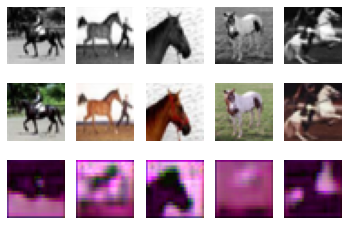

1 tensor(0.0303)
Loss:tensor(0.0303, device='cuda:0', grad_fn=<MseLossBackward0>)


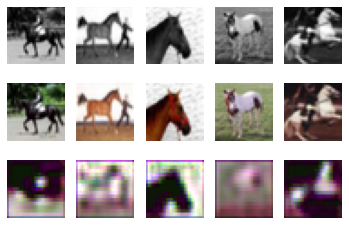

2 tensor(0.0219)
Loss:tensor(0.0219, device='cuda:0', grad_fn=<MseLossBackward0>)


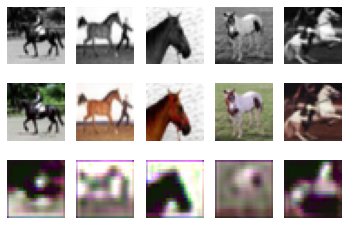

3 tensor(0.0185)
Loss:tensor(0.0185, device='cuda:0', grad_fn=<MseLossBackward0>)


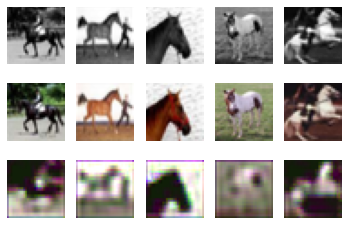

4 tensor(0.0166)
Loss:tensor(0.0166, device='cuda:0', grad_fn=<MseLossBackward0>)


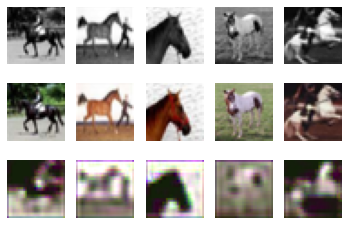

5 tensor(0.0152)
Loss:tensor(0.0152, device='cuda:0', grad_fn=<MseLossBackward0>)


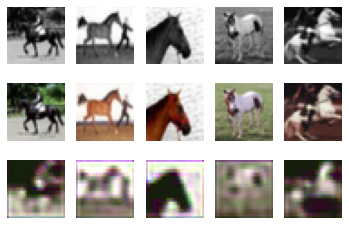

6 tensor(0.0143)
Loss:tensor(0.0143, device='cuda:0', grad_fn=<MseLossBackward0>)


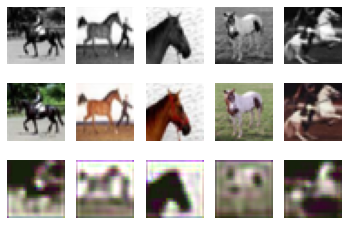

7 tensor(0.0136)
Loss:tensor(0.0136, device='cuda:0', grad_fn=<MseLossBackward0>)


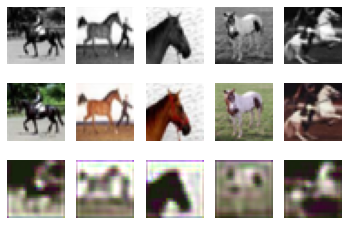

8 tensor(0.0131)
Loss:tensor(0.0131, device='cuda:0', grad_fn=<MseLossBackward0>)


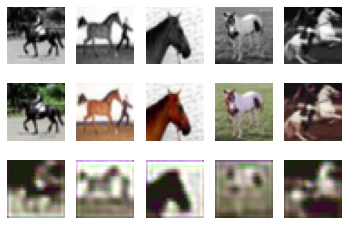

9 tensor(0.0126)
Loss:tensor(0.0126, device='cuda:0', grad_fn=<MseLossBackward0>)


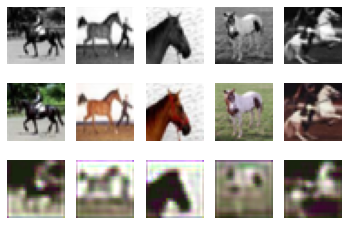

10 tensor(0.0123)
Loss:tensor(0.0123, device='cuda:0', grad_fn=<MseLossBackward0>)


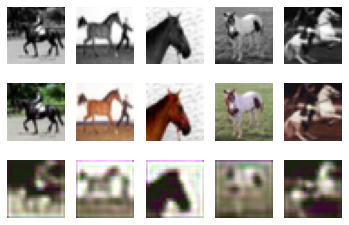

11 tensor(0.0119)
Loss:tensor(0.0119, device='cuda:0', grad_fn=<MseLossBackward0>)


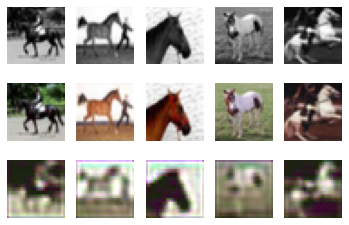

12 tensor(0.0117)
Loss:tensor(0.0117, device='cuda:0', grad_fn=<MseLossBackward0>)


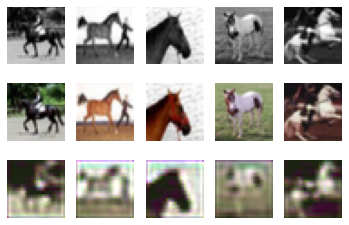

13 tensor(0.0115)
Loss:tensor(0.0115, device='cuda:0', grad_fn=<MseLossBackward0>)


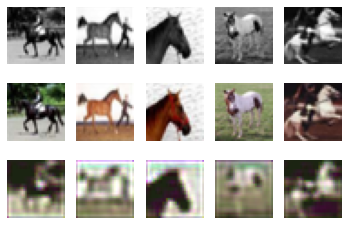

14 tensor(0.0112)
Loss:tensor(0.0112, device='cuda:0', grad_fn=<MseLossBackward0>)


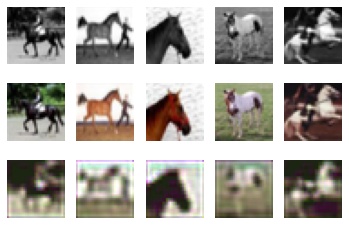

15 tensor(0.0109)
Loss:tensor(0.0109, device='cuda:0', grad_fn=<MseLossBackward0>)


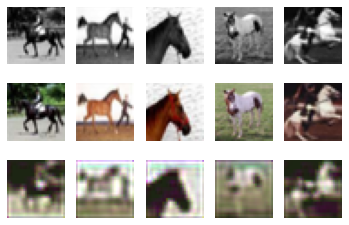

16 tensor(0.0107)
Loss:tensor(0.0107, device='cuda:0', grad_fn=<MseLossBackward0>)


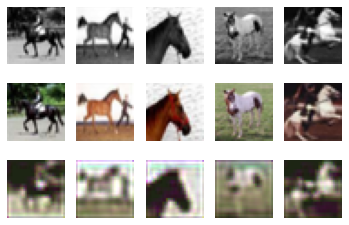

17 tensor(0.0105)
Loss:tensor(0.0105, device='cuda:0', grad_fn=<MseLossBackward0>)


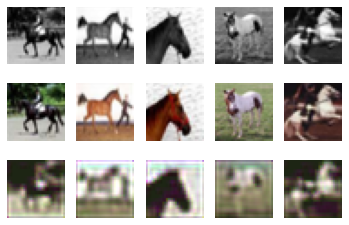

18 tensor(0.0102)
Loss:tensor(0.0102, device='cuda:0', grad_fn=<MseLossBackward0>)


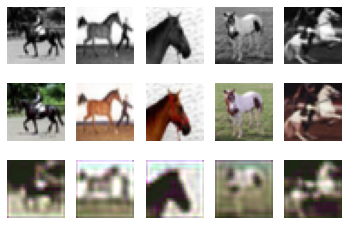

19 tensor(0.0101)
Loss:tensor(0.0101, device='cuda:0', grad_fn=<MseLossBackward0>)


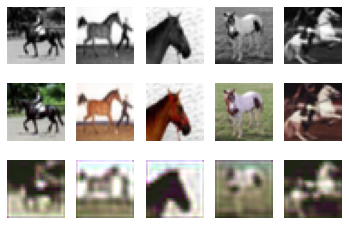

20 tensor(0.0100)
Loss:tensor(0.0100, device='cuda:0', grad_fn=<MseLossBackward0>)


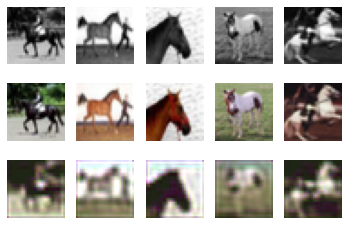

21 tensor(0.0099)
Loss:tensor(0.0099, device='cuda:0', grad_fn=<MseLossBackward0>)


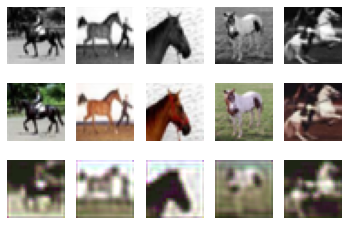

22 tensor(0.0098)
Loss:tensor(0.0098, device='cuda:0', grad_fn=<MseLossBackward0>)


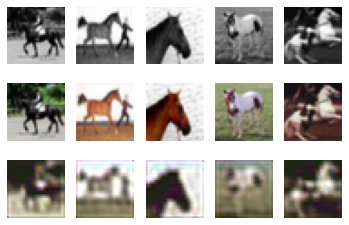

23 tensor(0.0096)
Loss:tensor(0.0096, device='cuda:0', grad_fn=<MseLossBackward0>)


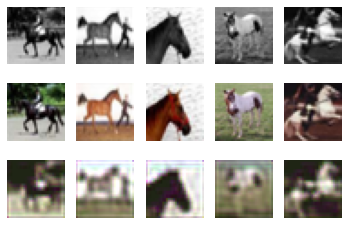

24 tensor(0.0095)
Loss:tensor(0.0095, device='cuda:0', grad_fn=<MseLossBackward0>)


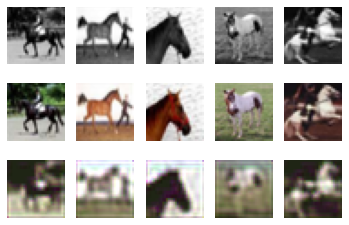

Final Loss: 0.009539909660816193


In [ ]:
#Main training loop for CNN
args = AttrDict()
args_dict = {
    "gpu": True,
    "valid": False,
    "checkpoint": "",
    "colours": "./data/colours/colour_kmeans24_cat7.npy",
    "model": "RegressionCNN",
    "kernel": 3,
    "num_filters": 32,
    'learn_rate':0.001, 
    "batch_size": 100,
    "epochs": 25,
    "seed": 0,
    "plot": True,
    "experiment_name": "colourization_cnn",
    "visualize": False,
    "downsize_input": False,
}

args.update(args_dict)
cnn = train(args)

We can see that the color prediction is not doing that well since the number of epochs is only 25. Maybe if we increase the epochs we can make better predictions. The final loss is reported to be 0.00954.

### Part (a) [1 pt]
Describe the model RegressionCNN. How many convolution layers does it have? What are the filter sizes and number of filters at each layer? Construct a table or draw a diagram.

**Answer**

It has 6 convolutional layers:
- downconv1--> filter sizes: 1x3x3 (CHW), Num of filters: 32
- downconv2--> filter sizes: 32x3x3, Num of filters: 64
- rfconv--> filter sizes: 64x3x3, Num of filters: 64
- upconv1--> filter sizes: 64x3x3, Num of filters: 32
- upconv2--> filter sizes: 32x3x3, Num of filters: 3
- finalconv--> filter sizes: 3x3x3, Num of filters: 3
- Total num of params: 75549

In [ ]:
model=RegressionCNN(kernel=3, num_filters=32)
pytorch_total_params = sum(p.numel() for p in model.parameters())
print(pytorch_total_params)

75549


### Part (b) [1 pt]
Run the regression training code (should run without errors). This will generate some images. How many epochs are we training the CNN model in the given setting?

**Answer:** We are training for 25 epochs.

### Part (c) [3 pt]
Re-train a couple of new models using a different number of training epochs. You may train each new models in a new code cell by copying and modifying the code from the last notebook cell. Comment on how the results (output images, training loss) change as we increase or decrease the number of epochs.

Training with 50 epochs

In [ ]:
#Main training loop for CNN
args = AttrDict()
args_dict = {
    "gpu": True,
    "valid": False,
    "checkpoint": "",
    "colours": "./data/colours/colour_kmeans24_cat7.npy",
    "model": "RegressionCNN",
    "kernel": 3,
    "num_filters": 32,
    'learn_rate':0.001, 
    "batch_size": 100,
    "epochs": 50,
    "seed": 0,
    "plot": True,
    "experiment_name": "colourization_cnn",
    "visualize": False,
    "downsize_input": False,
}

args.update(args_dict)
cnn = train(args)

**Answer**
Even after increasing the number of epochs to 50 the colors are still not predicted well. We can see most images are a dull greenish color. The loss is 0.0067, which is lower compared to our previous loss (with 25 epochs), but we can see we need to achieve much lower loss to predict more accurate colors. So lets increase the number of epochs to 500.

In [ ]:
#Main training loop for CNN
args = AttrDict()
args_dict = {
    "gpu": True,
    "valid": False,
    "checkpoint": "",
    "colours": "./data/colours/colour_kmeans24_cat7.npy",
    "model": "RegressionCNN",
    "kernel": 3,
    "num_filters": 32,
    'learn_rate':0.001, 
    "batch_size": 100,
    "epochs": 500,
    "seed": 0,
    "plot": True,
    "experiment_name": "colourization_cnn",
    "visualize": False,
    "downsize_input": False,
}

args.update(args_dict)
cnn = train(args)

The loss is 0.00416, which is much lower our previous losses. However, overall the images still look dull and so should be trained for longer maybe 1000 epochs.
As we can see training for 500 iterations hasn;t improved the color predictions that much and the images look mostly brown and dull. So I think increasing the number of epochs even mor might not lead to any improvement rather we should focus on chnaging the architecture to predict more brighter colors.

## Part 3. Skip Connections [8 pt]
A skip connection in a neural network is a connection which skips one or more layer and connects to a later layer. We will introduce skip connections.

### Part (a) [4 pt]
Add a skip connection from the first layer to the last, second layer to the second last, etc.
That is, the final convolution should have both the output of the previous layer and the initial greyscale input as input. This type of skip-connection is introduced by [3], and is called a "UNet". Following the CNN class that you have completed, complete the __init__ and forward methods of the UNet class.
Hint: You will need to use the function torch.cat.

I have tried to mimic the Unet architecture from our lecture slides.

In [ ]:
# Edited #complete the code # Deep Unet= Autoencoder + skip connections
# img pixels: 32x32 pixels

class UNet(nn.Module):
    def __init__(self, kernel, num_filters, num_colours=3, num_in_channels=1):
        super(UNet, self).__init__()

        # Useful parameters
        stride = 2
        padding = kernel // 2
        output_padding = 1

        ############### YOUR CODE GOES HERE ############### 
        ###################################################

        # Formula to compute conv dimension: n_out= (n_in+2(p)-k / s) +1
        # Formula to compute dconv dimension: n_out= s(n_in-1)+ k -2(p)

        #encoder 
        self.conv1 = nn.Conv2d(1, 64, 2, stride= stride, padding= padding)  # padding=2//2 =floor(1)= 1 #n_out= 17
        self.conv2= nn.Conv2d(64, 128, 2, stride=stride, padding=padding)  # n_out= 9.5= 9
        self.conv3= nn.Conv2d(128, 256, 2, stride=stride, padding=padding) # n_out= 5.5=5
        self.conv4= nn.Conv2d(256, 512, 2, stride=stride, padding=padding) # n_out= 3.5=3
        self.conv5= nn.Conv2d(512, 1024, 2) # Econding conv   # n_out= 2
       
        
        #decoder
        self.dconv1= nn.ConvTranspose2d(1024, 512, 2) # n_out=3
        self.dconv2= nn.ConvTranspose2d(512+512, 256, 2, stride=stride, padding=padding, output_padding = output_padding ) # n_out=4+1=5
        self.dconv3= nn.ConvTranspose2d(256+256, 128, 2, stride=stride, padding=padding, output_padding =output_padding ) # n_out=8+1=9
        self.dconv4= nn.ConvTranspose2d(128+128, 64, 2, stride=stride, padding=padding,  output_padding =output_padding) # n_out=16+1=17
        self.dconv5= nn.ConvTranspose2d(64+64, 3, 2, stride=stride, padding=padding) # n_out=32
        
        


    def forward(self, x):
        ############### YOUR CODE GOES HERE ###############
        ###################################################

         x1 = F.relu(self.conv1(x))
         x2 = F.relu(self.conv2(x1))
         x3 = F.relu(self.conv3(x2)) 
         x4 = F.relu(self.conv4(x3)) 
         x5 = self.conv5(x4) # Encoding layer

         # Decoding
         x= F.relu(self.dconv1(x5))
         x= F.relu(self.dconv2(torch.cat([x, x4], dim=1))) # torch.cat([x, conv3], dim=1)  #F.relu(self.dconv2(x + x2)) 
         x= F.relu(self.dconv3(torch.cat([x, x3], dim=1))) 
         x= F.relu(self.dconv4(torch.cat([x, x2], dim=1))) 
         out= torch.sigmoid(self.dconv5(torch.cat([x, x1], dim=1))) ##F.relu(self.dconv3(x + x1))

         return out

### Part (b) [2 pt]
Train the "UNet" model for the same amount of epochs as the previous CNN and plot the training curve using a batch size of 100. How does the result compare to the previous model? Did skip connections improve the validation loss and accuracy? Did the skip connections improve the output qualitatively? How? Give at least two reasons why skip connections might improve the performance of our CNN models. 

**Answer** 

I used 100 epochs for the first try instead of 500 epochs to keep the training time managable and also because we have to try out different batch sizes. The results are much better than the previos model. With previous model even after running for 500 epochs the results weren't good and final loss was 0.0041622. Now we can see the color predictions are almost identical to the original images so qualitatively Unet is producing much better results. Also quantitatively it is also doing better since the final loss is 0.00106, much lower. 

This improvement was mainly due to skip connections. 
1. Skip connection allows the network to pass information from endoing layer to their corresponding decoding layers to help decode the images more effectively by recovering the spatial information lost during downsampling. These information could be things like how to color the images for that layer's resolution and other useful features related to image of that particular dimension. Hence the decoding is more effective since it has more information and can produce better predictions for the color of images (aka feature reuability).
2. Skip connections also address the degredation problem which is the issue of vanishing or exploding gardients which results from multiple chain rule back progations especially when the networks is deep (has many layers)

In [ ]:
# Creating a new name to save overfit models
def get_model_name(name, batch_size, learning_rate, epoch):
  
    path = "Saved_model_{0}_bs{1}_lr{2}_epoch{3}".format(name,
                                                   batch_size,
                                                   learning_rate,
                                                   epoch)
    return path


In [ ]:
class AttrDict(dict):
    def __init__(self, *args, **kwargs):
        super(AttrDict, self).__init__(*args, **kwargs)
        self.__dict__ = self

def get_torch_vars(xs, ys, gpu=False):
    """
    Helper function to convert numpy arrays to pytorch tensors.
    If GPU is used, move the tensors to GPU.

    Args:
      xs (float numpy tenosor): greyscale input
      ys (int numpy tenosor): rgb as labels
      gpu (bool): whether to move pytorch tensor to GPU
    Returns:
      Variable(xs), Variable(ys)
    """
    xs = torch.from_numpy(xs).float()
    ys = torch.from_numpy(ys).float()
    if gpu:
        xs = xs.cuda()
        ys = ys.cuda()
    return Variable(xs), Variable(ys)

def train(args, gen=None):

    # Numpy random seed
    npr.seed(args.seed)

    # Save directory
    save_dir = "outputs/" + args.experiment_name

    # LOAD THE MODEL
    if gen is None:
        Net = globals()[args.model]
        gen = Net(args.kernel, args.num_filters)

    # LOSS FUNCTION
    criterion = nn.MSELoss()
    optimizer = torch.optim.Adam(gen.parameters(), lr=args.learn_rate)

    # DATA
    print("Loading data...")
    (x_train, y_train), (x_test, y_test) = load_cifar10()

    print("Transforming data...")
    train_rgb, train_grey = process(x_train, y_train, downsize_input=args.downsize_input)
    test_rgb, test_grey = process(x_test, y_test, downsize_input=args.downsize_input)

    # Create the outputs folder if not created already
    if not os.path.exists(save_dir):
        os.makedirs(save_dir)

    print("Beginning training ...")
    if args.gpu:
        gen.cuda()
    start = time.time()

    iters= [] #new
    loss_in_iter=[] #new
    n = 0 #new

    train_losses = []
    valid_losses = []
    valid_accs = []

    start_time = time.time()
    
    for epoch in range(args.epochs):
        # Train the Model
        gen.train()  # Change model to 'train' mode
        losses = []
        for i, (xs, ys) in enumerate(get_batch(train_grey, train_rgb, args.batch_size)):
            images, labels = get_torch_vars(xs, ys, args.gpu)
            # Forward + Backward + Optimize
            optimizer.zero_grad()
            outputs = gen(images)

            iters.append(n)

            loss = criterion(outputs, labels)
            loss.backward()
            optimizer.step()
            losses.append(loss.data.item())

            loss_in_iter.append(float(loss)) # MSE loss is average loss  # compute *average* loss #loss_in_iter.append(float(loss)/args.batch_size)  

            n = n+1

            # Save the current model (checkpoint) to a file
            #model_path = get_model_name(args.experiment_name, args.batch_size, args.learn_rate, epoch)
            #torch.save(gen.state_dict(), model_path)
        
        print(epoch, loss.cpu().detach())
        print("Loss:" + str(loss))
        if args.plot:
          visual(images, labels, outputs, args.gpu, 1)

    end_time = time.time()
    elapsed_time = end_time - start_time

    # plotting
    plt.title("Training Loss Curve")
    plt.plot(iters, loss_in_iter, label="Train")
    plt.xlabel("Iterations")
    plt.ylabel("Loss")
    plt.show()



    print("Final Loss: {}".format(losses[-1]))
    print("Total time elapsed: {:.2f} seconds".format(elapsed_time))
    
    return gen

Batchsize: 100, epochs: 100

Loading data...
File path: data/cifar-10-batches-py.tar.gz
Transforming data...
Beginning training ...
0 tensor(0.0133)
Loss:tensor(0.0133, device='cuda:0', grad_fn=<MseLossBackward0>)


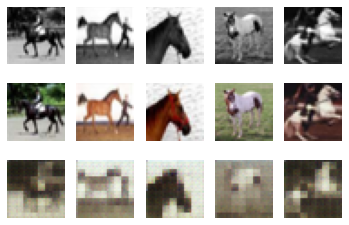

1 tensor(0.0074)
Loss:tensor(0.0074, device='cuda:0', grad_fn=<MseLossBackward0>)


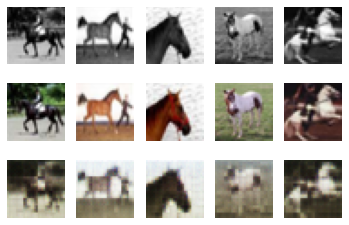

2 tensor(0.0058)
Loss:tensor(0.0058, device='cuda:0', grad_fn=<MseLossBackward0>)


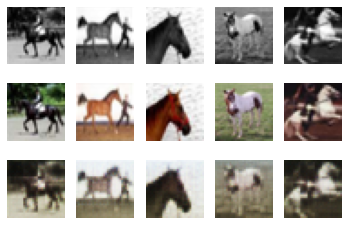

3 tensor(0.0051)
Loss:tensor(0.0051, device='cuda:0', grad_fn=<MseLossBackward0>)


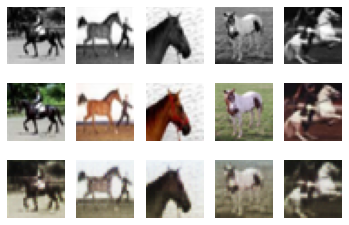

4 tensor(0.0048)
Loss:tensor(0.0048, device='cuda:0', grad_fn=<MseLossBackward0>)


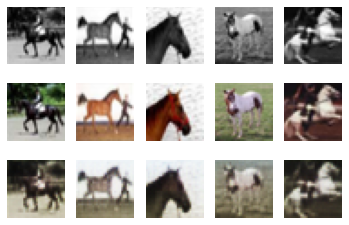

5 tensor(0.0045)
Loss:tensor(0.0045, device='cuda:0', grad_fn=<MseLossBackward0>)


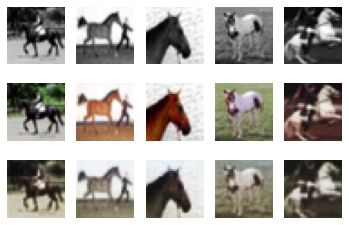

6 tensor(0.0044)
Loss:tensor(0.0044, device='cuda:0', grad_fn=<MseLossBackward0>)


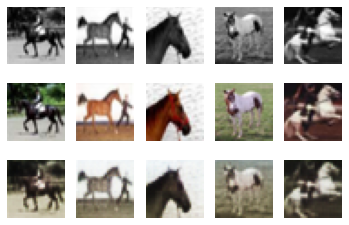

7 tensor(0.0042)
Loss:tensor(0.0042, device='cuda:0', grad_fn=<MseLossBackward0>)


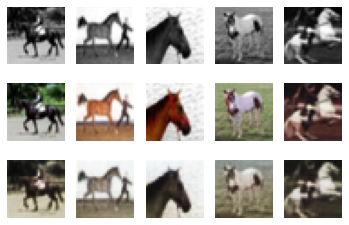

8 tensor(0.0041)
Loss:tensor(0.0041, device='cuda:0', grad_fn=<MseLossBackward0>)


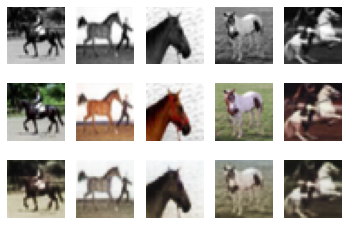

9 tensor(0.0040)
Loss:tensor(0.0040, device='cuda:0', grad_fn=<MseLossBackward0>)


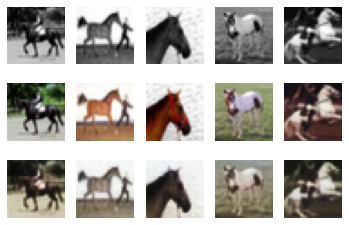

10 tensor(0.0039)
Loss:tensor(0.0039, device='cuda:0', grad_fn=<MseLossBackward0>)


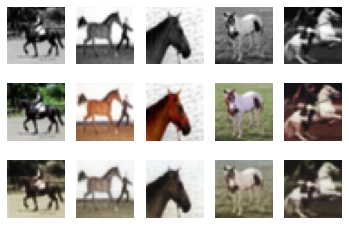

11 tensor(0.0038)
Loss:tensor(0.0038, device='cuda:0', grad_fn=<MseLossBackward0>)


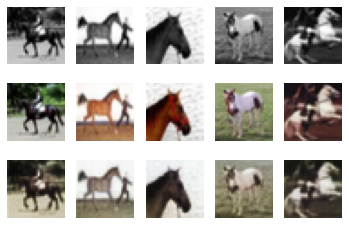

12 tensor(0.0038)
Loss:tensor(0.0038, device='cuda:0', grad_fn=<MseLossBackward0>)


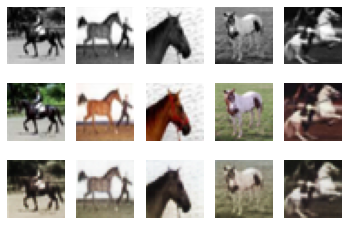

13 tensor(0.0038)
Loss:tensor(0.0038, device='cuda:0', grad_fn=<MseLossBackward0>)


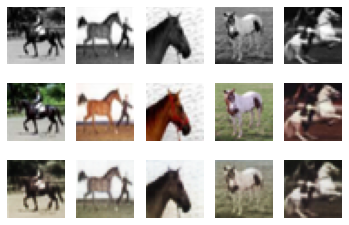

14 tensor(0.0038)
Loss:tensor(0.0038, device='cuda:0', grad_fn=<MseLossBackward0>)


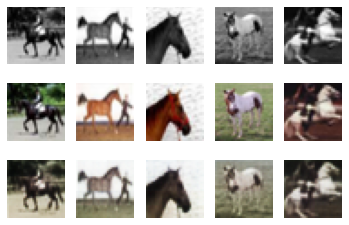

15 tensor(0.0037)
Loss:tensor(0.0037, device='cuda:0', grad_fn=<MseLossBackward0>)


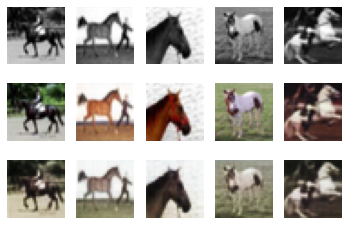

16 tensor(0.0037)
Loss:tensor(0.0037, device='cuda:0', grad_fn=<MseLossBackward0>)


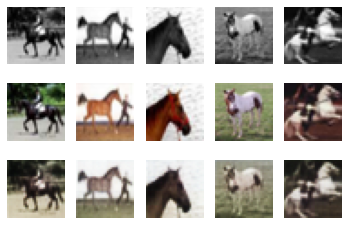

17 tensor(0.0036)
Loss:tensor(0.0036, device='cuda:0', grad_fn=<MseLossBackward0>)


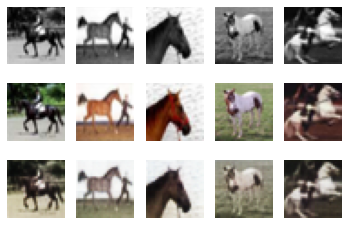

18 tensor(0.0037)
Loss:tensor(0.0037, device='cuda:0', grad_fn=<MseLossBackward0>)


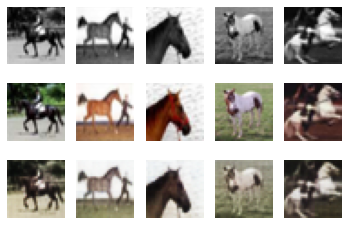

19 tensor(0.0036)
Loss:tensor(0.0036, device='cuda:0', grad_fn=<MseLossBackward0>)


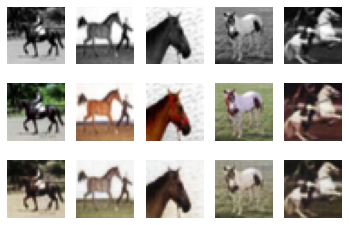

20 tensor(0.0033)
Loss:tensor(0.0033, device='cuda:0', grad_fn=<MseLossBackward0>)


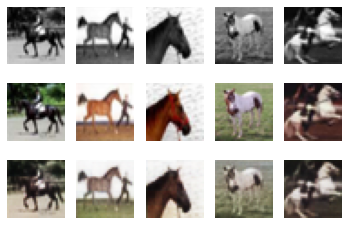

21 tensor(0.0032)
Loss:tensor(0.0032, device='cuda:0', grad_fn=<MseLossBackward0>)


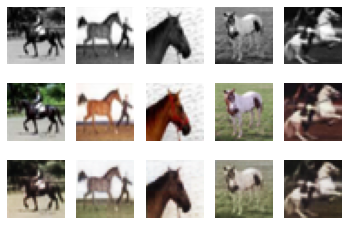

22 tensor(0.0031)
Loss:tensor(0.0031, device='cuda:0', grad_fn=<MseLossBackward0>)


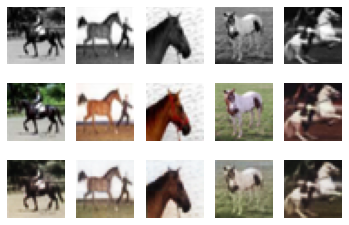

23 tensor(0.0031)
Loss:tensor(0.0031, device='cuda:0', grad_fn=<MseLossBackward0>)


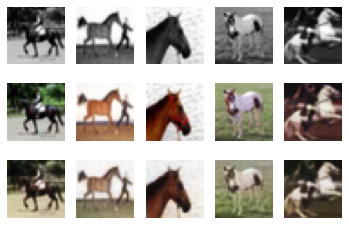

24 tensor(0.0030)
Loss:tensor(0.0030, device='cuda:0', grad_fn=<MseLossBackward0>)


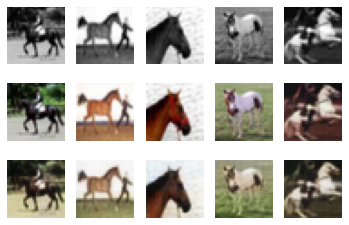

25 tensor(0.0029)
Loss:tensor(0.0029, device='cuda:0', grad_fn=<MseLossBackward0>)


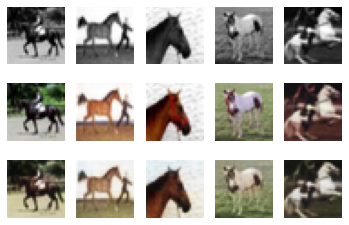

26 tensor(0.0028)
Loss:tensor(0.0028, device='cuda:0', grad_fn=<MseLossBackward0>)


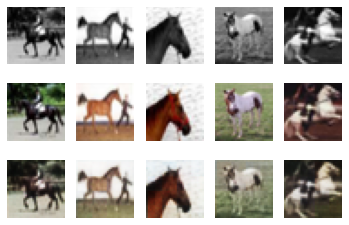

27 tensor(0.0026)
Loss:tensor(0.0026, device='cuda:0', grad_fn=<MseLossBackward0>)


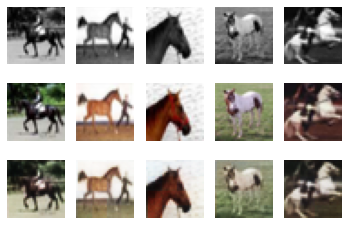

28 tensor(0.0025)
Loss:tensor(0.0025, device='cuda:0', grad_fn=<MseLossBackward0>)


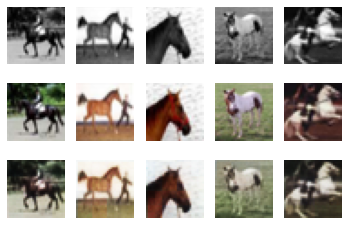

29 tensor(0.0027)
Loss:tensor(0.0027, device='cuda:0', grad_fn=<MseLossBackward0>)


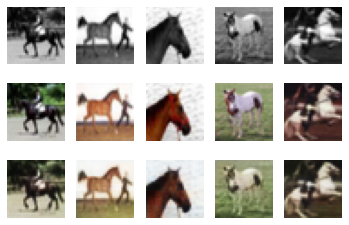

30 tensor(0.0025)
Loss:tensor(0.0025, device='cuda:0', grad_fn=<MseLossBackward0>)


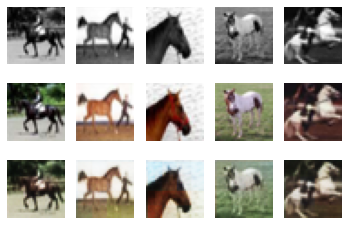

31 tensor(0.0024)
Loss:tensor(0.0024, device='cuda:0', grad_fn=<MseLossBackward0>)


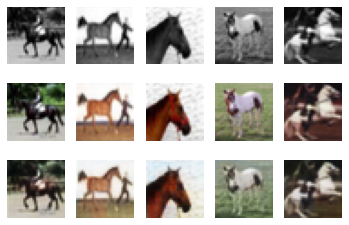

32 tensor(0.0025)
Loss:tensor(0.0025, device='cuda:0', grad_fn=<MseLossBackward0>)


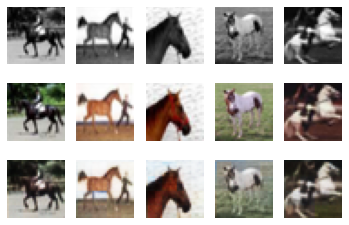

33 tensor(0.0025)
Loss:tensor(0.0025, device='cuda:0', grad_fn=<MseLossBackward0>)


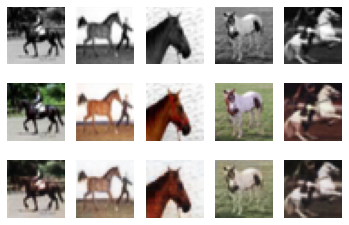

34 tensor(0.0026)
Loss:tensor(0.0026, device='cuda:0', grad_fn=<MseLossBackward0>)


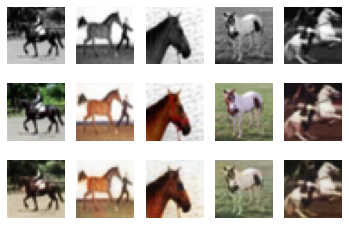

35 tensor(0.0023)
Loss:tensor(0.0023, device='cuda:0', grad_fn=<MseLossBackward0>)


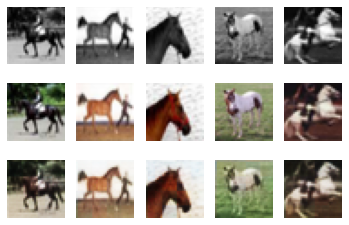

36 tensor(0.0020)
Loss:tensor(0.0020, device='cuda:0', grad_fn=<MseLossBackward0>)


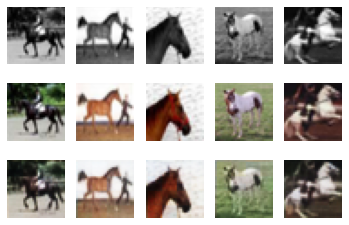

37 tensor(0.0020)
Loss:tensor(0.0020, device='cuda:0', grad_fn=<MseLossBackward0>)


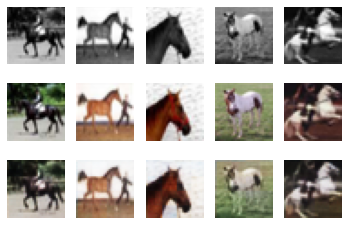

38 tensor(0.0020)
Loss:tensor(0.0020, device='cuda:0', grad_fn=<MseLossBackward0>)


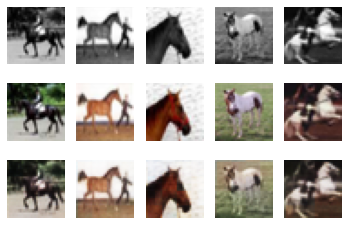

39 tensor(0.0022)
Loss:tensor(0.0022, device='cuda:0', grad_fn=<MseLossBackward0>)


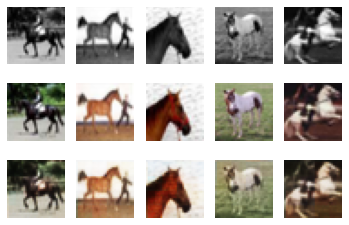

40 tensor(0.0019)
Loss:tensor(0.0019, device='cuda:0', grad_fn=<MseLossBackward0>)


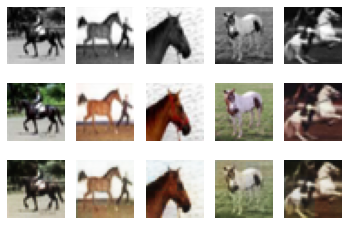

41 tensor(0.0019)
Loss:tensor(0.0019, device='cuda:0', grad_fn=<MseLossBackward0>)


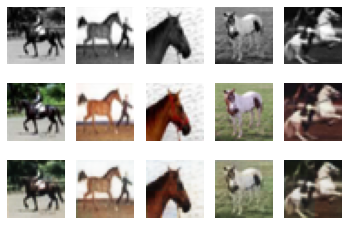

42 tensor(0.0017)
Loss:tensor(0.0017, device='cuda:0', grad_fn=<MseLossBackward0>)


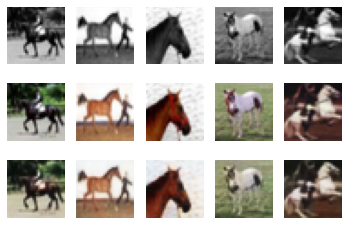

43 tensor(0.0021)
Loss:tensor(0.0021, device='cuda:0', grad_fn=<MseLossBackward0>)


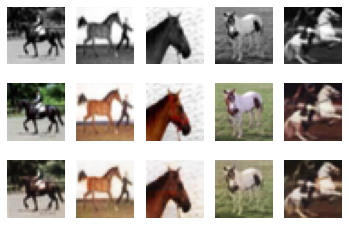

44 tensor(0.0021)
Loss:tensor(0.0021, device='cuda:0', grad_fn=<MseLossBackward0>)


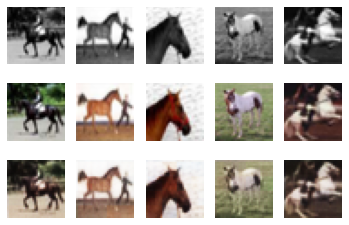

45 tensor(0.0019)
Loss:tensor(0.0019, device='cuda:0', grad_fn=<MseLossBackward0>)


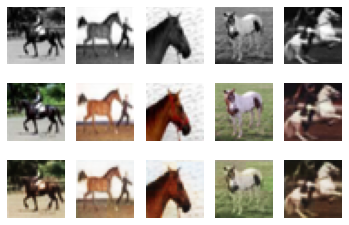

46 tensor(0.0019)
Loss:tensor(0.0019, device='cuda:0', grad_fn=<MseLossBackward0>)


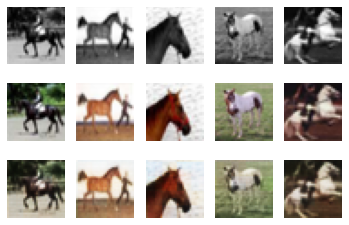

47 tensor(0.0019)
Loss:tensor(0.0019, device='cuda:0', grad_fn=<MseLossBackward0>)


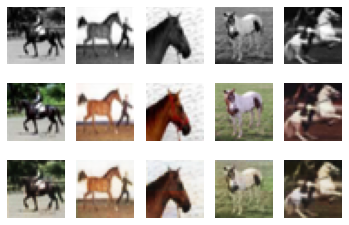

48 tensor(0.0018)
Loss:tensor(0.0018, device='cuda:0', grad_fn=<MseLossBackward0>)


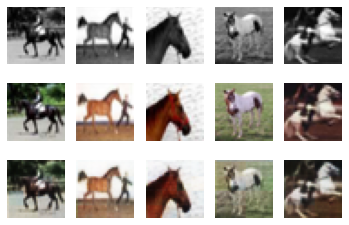

49 tensor(0.0016)
Loss:tensor(0.0016, device='cuda:0', grad_fn=<MseLossBackward0>)


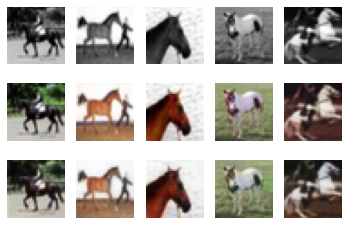

50 tensor(0.0017)
Loss:tensor(0.0017, device='cuda:0', grad_fn=<MseLossBackward0>)


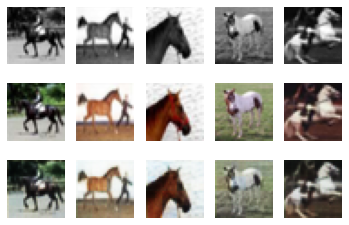

51 tensor(0.0017)
Loss:tensor(0.0017, device='cuda:0', grad_fn=<MseLossBackward0>)


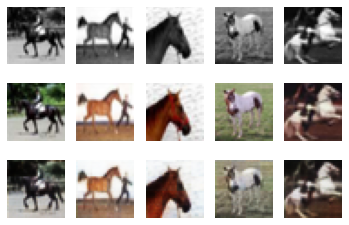

52 tensor(0.0016)
Loss:tensor(0.0016, device='cuda:0', grad_fn=<MseLossBackward0>)


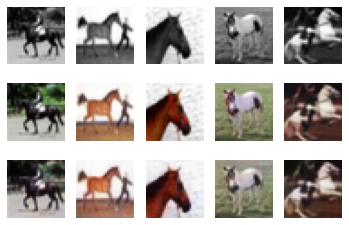

53 tensor(0.0015)
Loss:tensor(0.0015, device='cuda:0', grad_fn=<MseLossBackward0>)


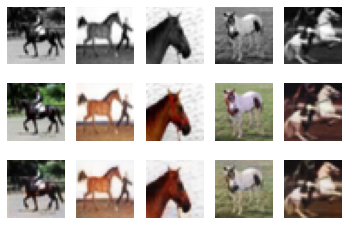

54 tensor(0.0015)
Loss:tensor(0.0015, device='cuda:0', grad_fn=<MseLossBackward0>)


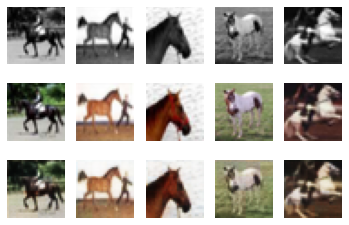

55 tensor(0.0014)
Loss:tensor(0.0014, device='cuda:0', grad_fn=<MseLossBackward0>)


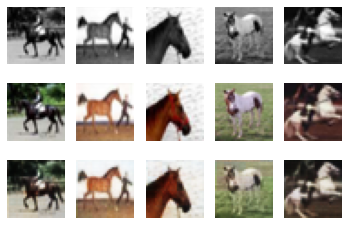

56 tensor(0.0015)
Loss:tensor(0.0015, device='cuda:0', grad_fn=<MseLossBackward0>)


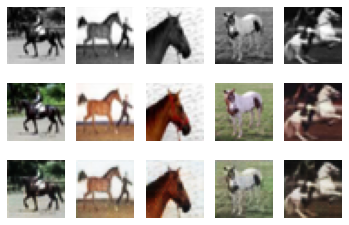

57 tensor(0.0015)
Loss:tensor(0.0015, device='cuda:0', grad_fn=<MseLossBackward0>)


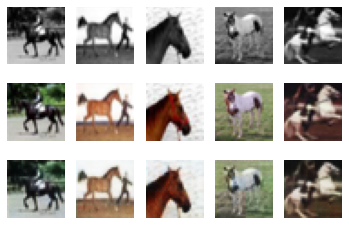

58 tensor(0.0016)
Loss:tensor(0.0016, device='cuda:0', grad_fn=<MseLossBackward0>)


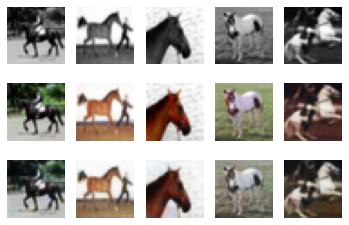

59 tensor(0.0015)
Loss:tensor(0.0015, device='cuda:0', grad_fn=<MseLossBackward0>)


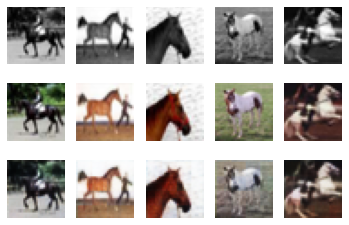

60 tensor(0.0014)
Loss:tensor(0.0014, device='cuda:0', grad_fn=<MseLossBackward0>)


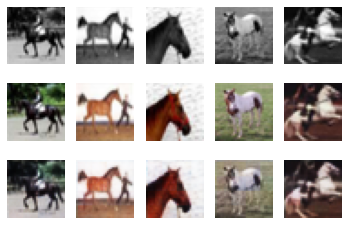

61 tensor(0.0013)
Loss:tensor(0.0013, device='cuda:0', grad_fn=<MseLossBackward0>)


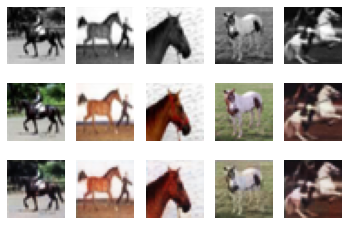

62 tensor(0.0012)
Loss:tensor(0.0012, device='cuda:0', grad_fn=<MseLossBackward0>)


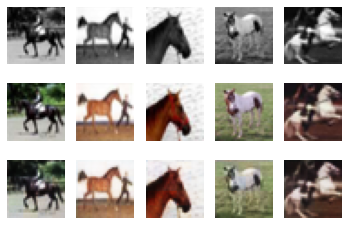

63 tensor(0.0012)
Loss:tensor(0.0012, device='cuda:0', grad_fn=<MseLossBackward0>)


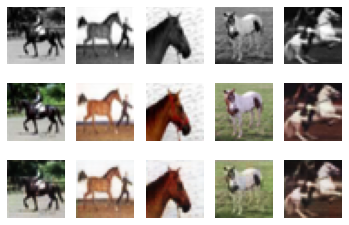

64 tensor(0.0013)
Loss:tensor(0.0013, device='cuda:0', grad_fn=<MseLossBackward0>)


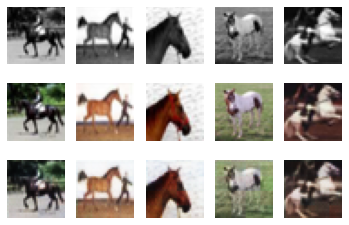

65 tensor(0.0013)
Loss:tensor(0.0013, device='cuda:0', grad_fn=<MseLossBackward0>)


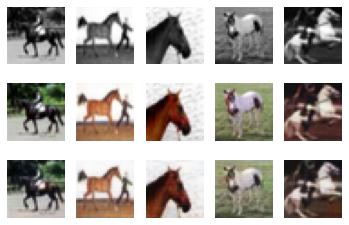

66 tensor(0.0014)
Loss:tensor(0.0014, device='cuda:0', grad_fn=<MseLossBackward0>)


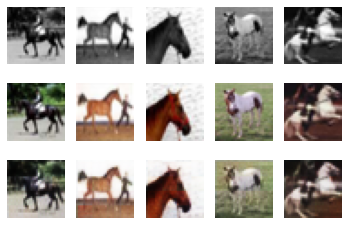

67 tensor(0.0014)
Loss:tensor(0.0014, device='cuda:0', grad_fn=<MseLossBackward0>)


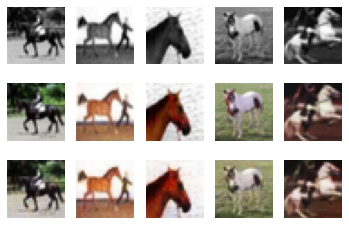

68 tensor(0.0016)
Loss:tensor(0.0016, device='cuda:0', grad_fn=<MseLossBackward0>)


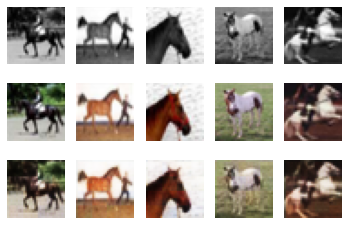

69 tensor(0.0013)
Loss:tensor(0.0013, device='cuda:0', grad_fn=<MseLossBackward0>)


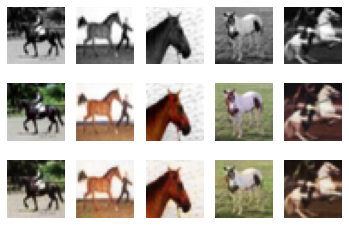

70 tensor(0.0014)
Loss:tensor(0.0014, device='cuda:0', grad_fn=<MseLossBackward0>)


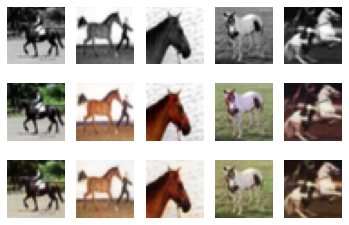

71 tensor(0.0013)
Loss:tensor(0.0013, device='cuda:0', grad_fn=<MseLossBackward0>)


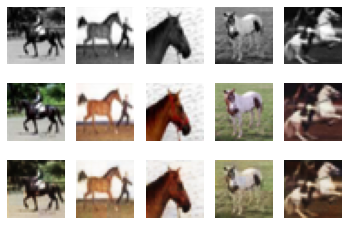

72 tensor(0.0010)
Loss:tensor(0.0010, device='cuda:0', grad_fn=<MseLossBackward0>)


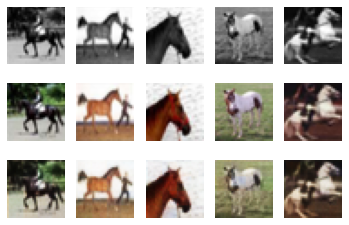

73 tensor(0.0010)
Loss:tensor(0.0010, device='cuda:0', grad_fn=<MseLossBackward0>)


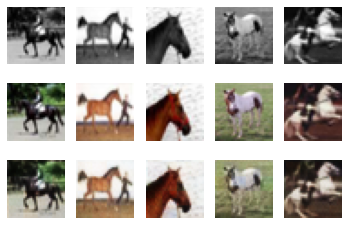

74 tensor(0.0011)
Loss:tensor(0.0011, device='cuda:0', grad_fn=<MseLossBackward0>)


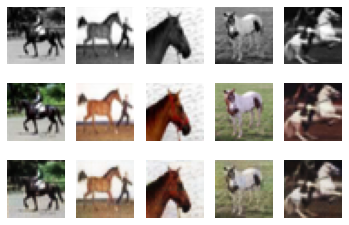

75 tensor(0.0011)
Loss:tensor(0.0011, device='cuda:0', grad_fn=<MseLossBackward0>)


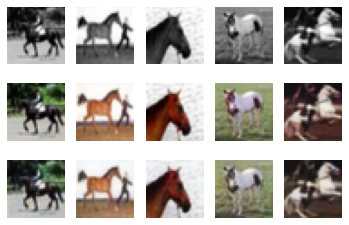

76 tensor(0.0012)
Loss:tensor(0.0012, device='cuda:0', grad_fn=<MseLossBackward0>)


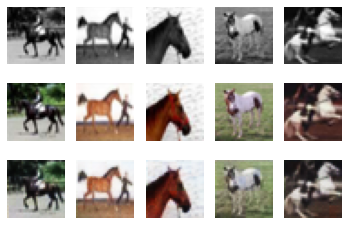

77 tensor(0.0013)
Loss:tensor(0.0013, device='cuda:0', grad_fn=<MseLossBackward0>)


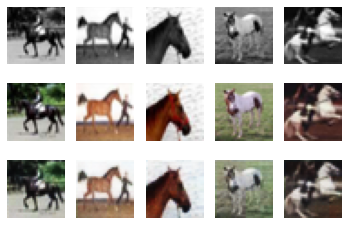

78 tensor(0.0011)
Loss:tensor(0.0011, device='cuda:0', grad_fn=<MseLossBackward0>)


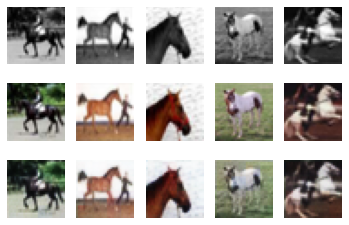

79 tensor(0.0010)
Loss:tensor(0.0010, device='cuda:0', grad_fn=<MseLossBackward0>)


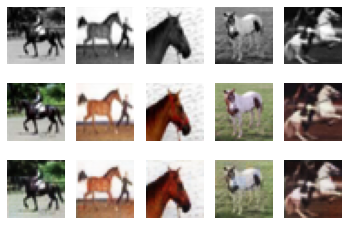

80 tensor(0.0011)
Loss:tensor(0.0011, device='cuda:0', grad_fn=<MseLossBackward0>)


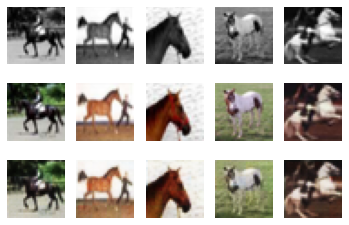

81 tensor(0.0010)
Loss:tensor(0.0010, device='cuda:0', grad_fn=<MseLossBackward0>)


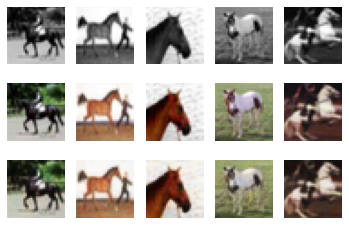

82 tensor(0.0009)
Loss:tensor(0.0009, device='cuda:0', grad_fn=<MseLossBackward0>)


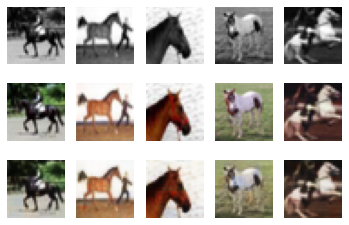

83 tensor(0.0011)
Loss:tensor(0.0011, device='cuda:0', grad_fn=<MseLossBackward0>)


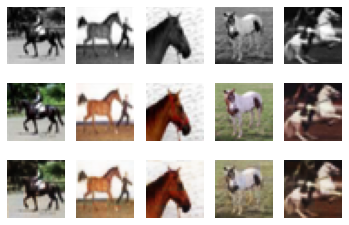

84 tensor(0.0010)
Loss:tensor(0.0010, device='cuda:0', grad_fn=<MseLossBackward0>)


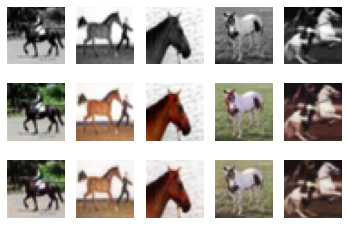

85 tensor(0.0009)
Loss:tensor(0.0009, device='cuda:0', grad_fn=<MseLossBackward0>)


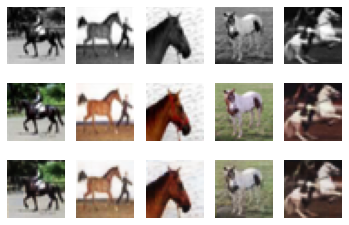

86 tensor(0.0009)
Loss:tensor(0.0009, device='cuda:0', grad_fn=<MseLossBackward0>)


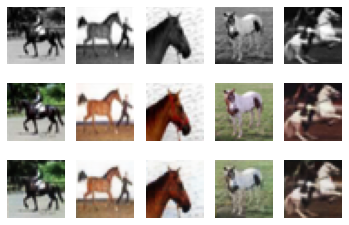

87 tensor(0.0010)
Loss:tensor(0.0010, device='cuda:0', grad_fn=<MseLossBackward0>)


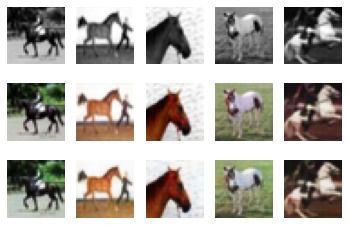

88 tensor(0.0009)
Loss:tensor(0.0009, device='cuda:0', grad_fn=<MseLossBackward0>)


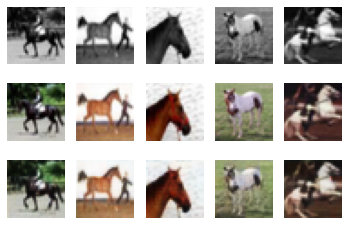

89 tensor(0.0008)
Loss:tensor(0.0008, device='cuda:0', grad_fn=<MseLossBackward0>)


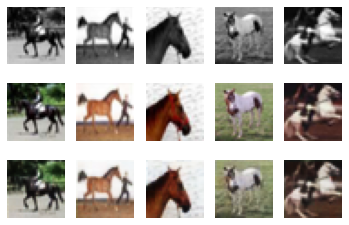

90 tensor(0.0008)
Loss:tensor(0.0008, device='cuda:0', grad_fn=<MseLossBackward0>)


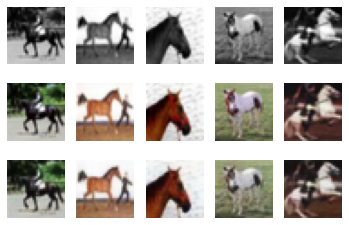

91 tensor(0.0008)
Loss:tensor(0.0008, device='cuda:0', grad_fn=<MseLossBackward0>)


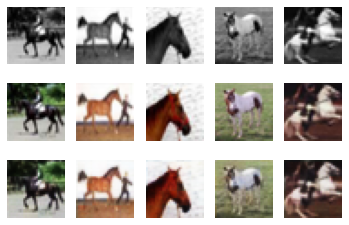

92 tensor(0.0009)
Loss:tensor(0.0009, device='cuda:0', grad_fn=<MseLossBackward0>)


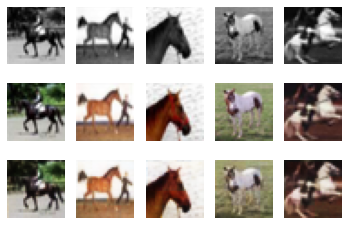

93 tensor(0.0009)
Loss:tensor(0.0009, device='cuda:0', grad_fn=<MseLossBackward0>)


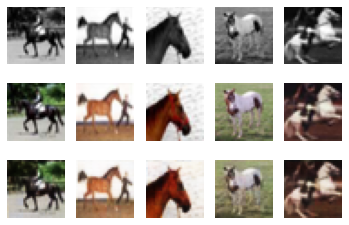

94 tensor(0.0010)
Loss:tensor(0.0010, device='cuda:0', grad_fn=<MseLossBackward0>)


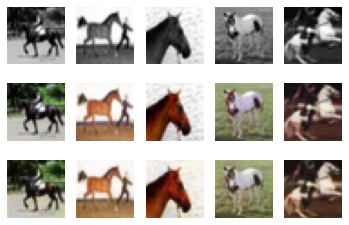

95 tensor(0.0010)
Loss:tensor(0.0010, device='cuda:0', grad_fn=<MseLossBackward0>)


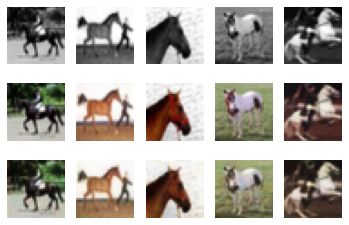

96 tensor(0.0009)
Loss:tensor(0.0009, device='cuda:0', grad_fn=<MseLossBackward0>)


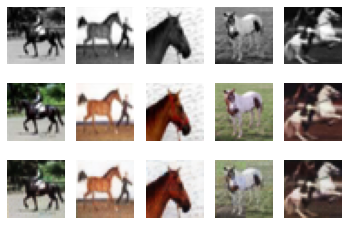

97 tensor(0.0011)
Loss:tensor(0.0011, device='cuda:0', grad_fn=<MseLossBackward0>)


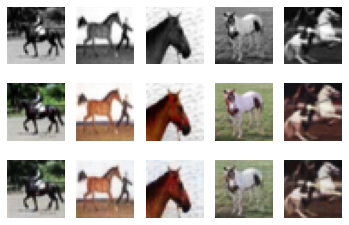

98 tensor(0.0012)
Loss:tensor(0.0012, device='cuda:0', grad_fn=<MseLossBackward0>)


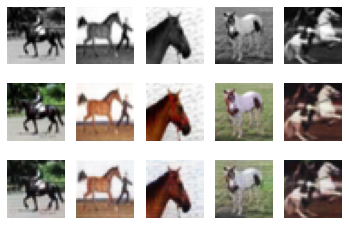

99 tensor(0.0011)
Loss:tensor(0.0011, device='cuda:0', grad_fn=<MseLossBackward0>)


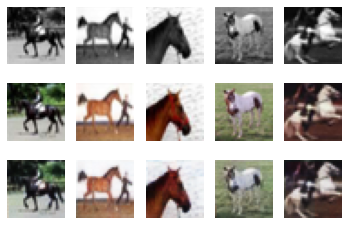

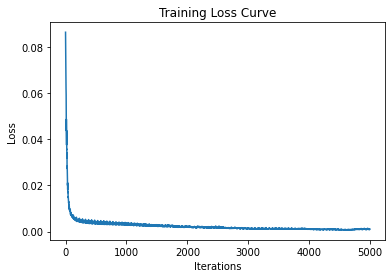

Final Loss: 0.001061215647496283
Total time elapsed: 171.24 seconds


In [ ]:
# Main training loop for UNet
args = AttrDict()
args_dict = {
    "gpu": True,
    "valid": False,
    "checkpoint": "",
    "colours": "./data/colours/colour_kmeans24_cat7.npy",
    "model": "UNet",
    "kernel": 2,
    "num_filters": 32,
    'learn_rate':0.001, 
    "batch_size": 100,
    "epochs": 100,
    "seed": 0,
    "plot": True,
    "experiment_name": "colourization_Unet",
    "visualize": False,
    "downsize_input": False,
}
args.update(args_dict)
cnn = train(args)

**Answer**
The training loss drastically decreases fir the first 200 iterations but then gradually flattens out. We can see our model has converged very quickly and is overfiting. This is not particularly bad since now we know our model is able to learn how to color images quickly when the dataset is small and so should also be able to generalize when provided larger datasets. So our skip connection model passed the sanity check. 

However in terms of image quality we can get suffient perofrmance after 50 epochs and great performnce at 100 epoch. 

After 100 epoch qualitatively also the images produced by the model are very good and infact almost identical to the original RGB images. This is why i will not keep the epoch to be 100 and only chnage the batch size.

### Part (c) [2 pt]
Re-train a few more "UNet" models using different mini batch sizes with a fixed number of epochs. Describe the effect of batch sizes on the training/validation loss, and the final image output.

Batchsize= 500, epoch=100

Loading data...
File path: data/cifar-10-batches-py.tar.gz
Transforming data...
Beginning training ...
0 tensor(0.0641)
Loss:tensor(0.0641, device='cuda:0', grad_fn=<MseLossBackward0>)


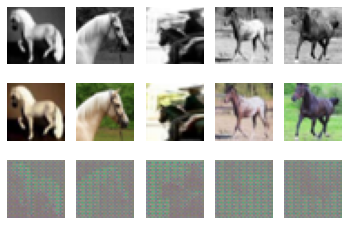

1 tensor(0.0410)
Loss:tensor(0.0410, device='cuda:0', grad_fn=<MseLossBackward0>)


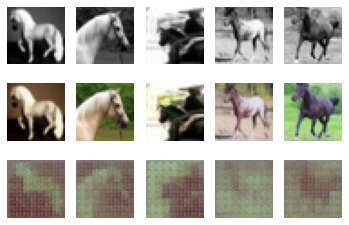

2 tensor(0.0212)
Loss:tensor(0.0212, device='cuda:0', grad_fn=<MseLossBackward0>)


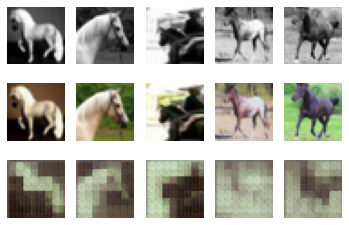

3 tensor(0.0149)
Loss:tensor(0.0149, device='cuda:0', grad_fn=<MseLossBackward0>)


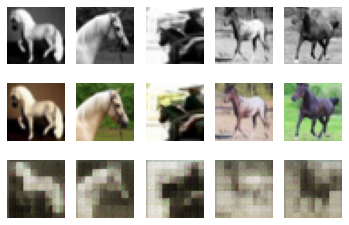

4 tensor(0.0115)
Loss:tensor(0.0115, device='cuda:0', grad_fn=<MseLossBackward0>)


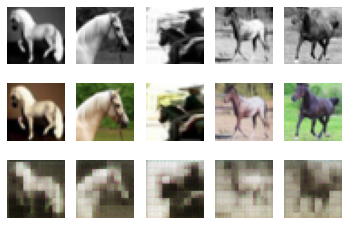

5 tensor(0.0093)
Loss:tensor(0.0093, device='cuda:0', grad_fn=<MseLossBackward0>)


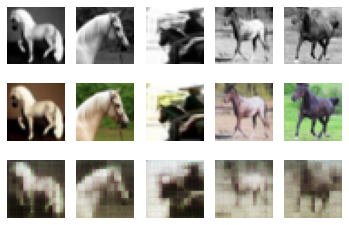

6 tensor(0.0080)
Loss:tensor(0.0080, device='cuda:0', grad_fn=<MseLossBackward0>)


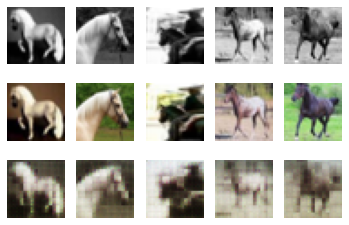

7 tensor(0.0074)
Loss:tensor(0.0074, device='cuda:0', grad_fn=<MseLossBackward0>)


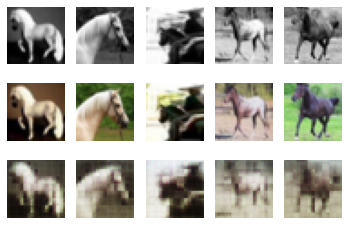

8 tensor(0.0070)
Loss:tensor(0.0070, device='cuda:0', grad_fn=<MseLossBackward0>)


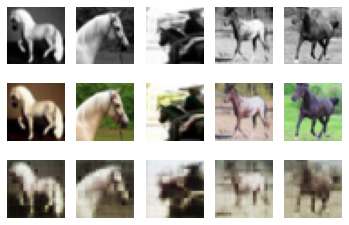

9 tensor(0.0066)
Loss:tensor(0.0066, device='cuda:0', grad_fn=<MseLossBackward0>)


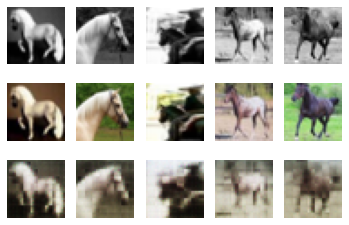

10 tensor(0.0063)
Loss:tensor(0.0063, device='cuda:0', grad_fn=<MseLossBackward0>)


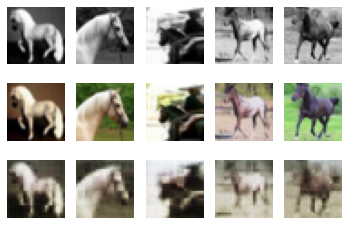

11 tensor(0.0060)
Loss:tensor(0.0060, device='cuda:0', grad_fn=<MseLossBackward0>)


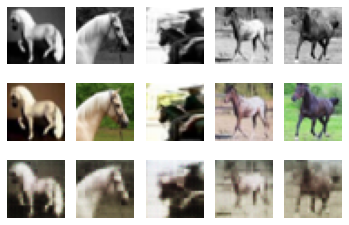

12 tensor(0.0056)
Loss:tensor(0.0056, device='cuda:0', grad_fn=<MseLossBackward0>)


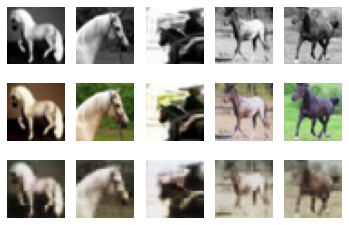

13 tensor(0.0054)
Loss:tensor(0.0054, device='cuda:0', grad_fn=<MseLossBackward0>)


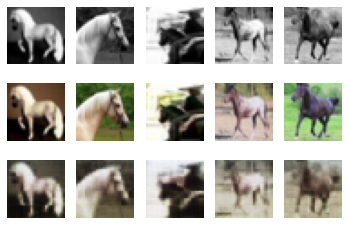

14 tensor(0.0052)
Loss:tensor(0.0052, device='cuda:0', grad_fn=<MseLossBackward0>)


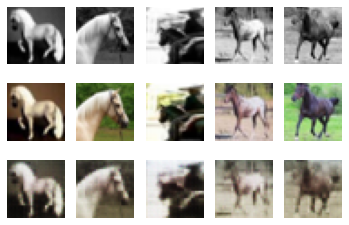

15 tensor(0.0050)
Loss:tensor(0.0050, device='cuda:0', grad_fn=<MseLossBackward0>)


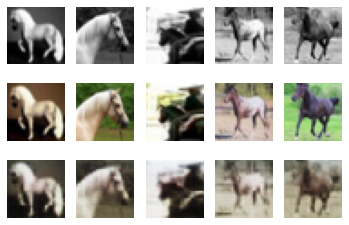

16 tensor(0.0048)
Loss:tensor(0.0048, device='cuda:0', grad_fn=<MseLossBackward0>)


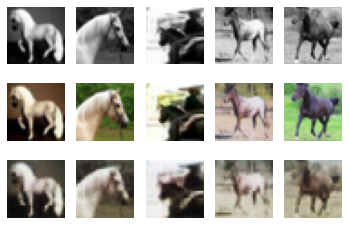

17 tensor(0.0047)
Loss:tensor(0.0047, device='cuda:0', grad_fn=<MseLossBackward0>)


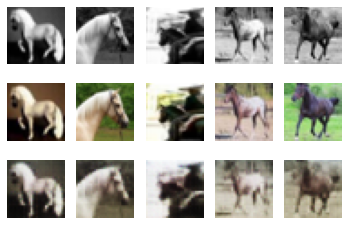

18 tensor(0.0046)
Loss:tensor(0.0046, device='cuda:0', grad_fn=<MseLossBackward0>)


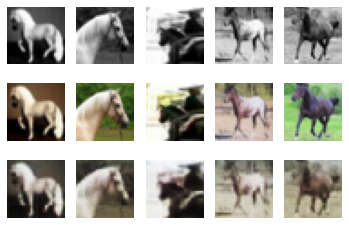

19 tensor(0.0045)
Loss:tensor(0.0045, device='cuda:0', grad_fn=<MseLossBackward0>)


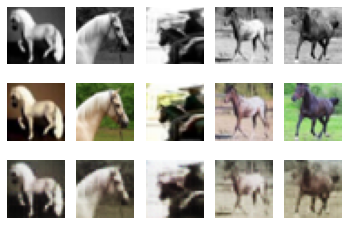

20 tensor(0.0045)
Loss:tensor(0.0045, device='cuda:0', grad_fn=<MseLossBackward0>)


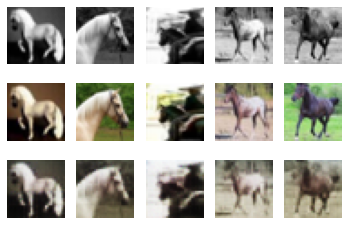

21 tensor(0.0044)
Loss:tensor(0.0044, device='cuda:0', grad_fn=<MseLossBackward0>)


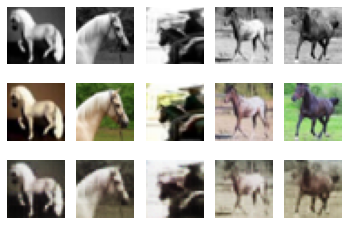

22 tensor(0.0043)
Loss:tensor(0.0043, device='cuda:0', grad_fn=<MseLossBackward0>)


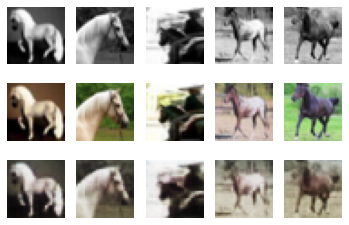

23 tensor(0.0043)
Loss:tensor(0.0043, device='cuda:0', grad_fn=<MseLossBackward0>)


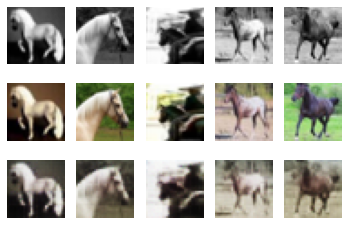

24 tensor(0.0042)
Loss:tensor(0.0042, device='cuda:0', grad_fn=<MseLossBackward0>)


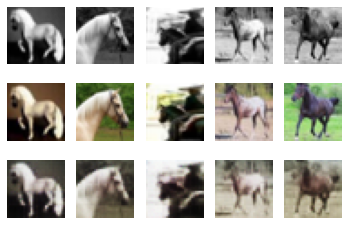

25 tensor(0.0042)
Loss:tensor(0.0042, device='cuda:0', grad_fn=<MseLossBackward0>)


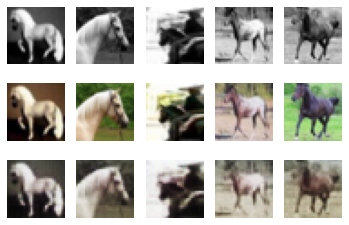

26 tensor(0.0041)
Loss:tensor(0.0041, device='cuda:0', grad_fn=<MseLossBackward0>)


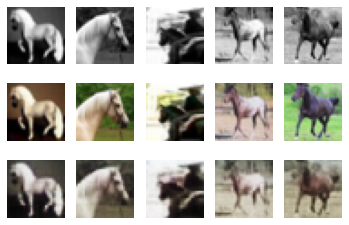

27 tensor(0.0041)
Loss:tensor(0.0041, device='cuda:0', grad_fn=<MseLossBackward0>)


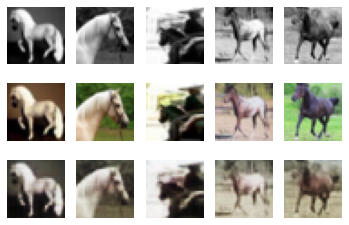

28 tensor(0.0040)
Loss:tensor(0.0040, device='cuda:0', grad_fn=<MseLossBackward0>)


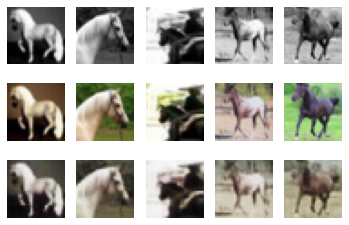

29 tensor(0.0040)
Loss:tensor(0.0040, device='cuda:0', grad_fn=<MseLossBackward0>)


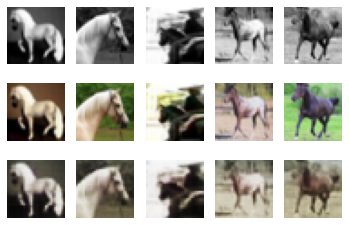

30 tensor(0.0039)
Loss:tensor(0.0039, device='cuda:0', grad_fn=<MseLossBackward0>)


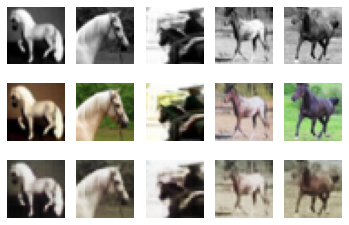

31 tensor(0.0039)
Loss:tensor(0.0039, device='cuda:0', grad_fn=<MseLossBackward0>)


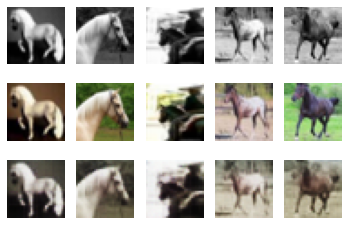

32 tensor(0.0038)
Loss:tensor(0.0038, device='cuda:0', grad_fn=<MseLossBackward0>)


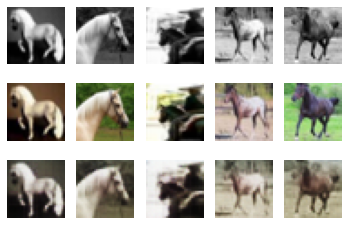

33 tensor(0.0038)
Loss:tensor(0.0038, device='cuda:0', grad_fn=<MseLossBackward0>)


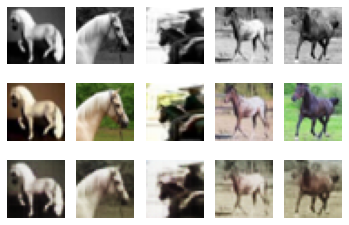

34 tensor(0.0038)
Loss:tensor(0.0038, device='cuda:0', grad_fn=<MseLossBackward0>)


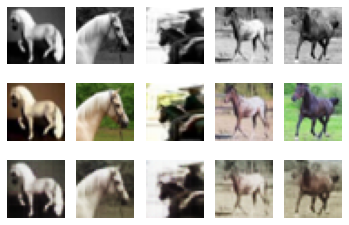

35 tensor(0.0037)
Loss:tensor(0.0037, device='cuda:0', grad_fn=<MseLossBackward0>)


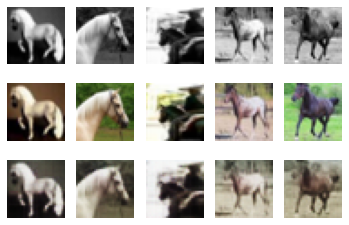

36 tensor(0.0037)
Loss:tensor(0.0037, device='cuda:0', grad_fn=<MseLossBackward0>)


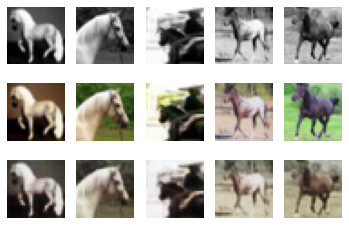

37 tensor(0.0036)
Loss:tensor(0.0036, device='cuda:0', grad_fn=<MseLossBackward0>)


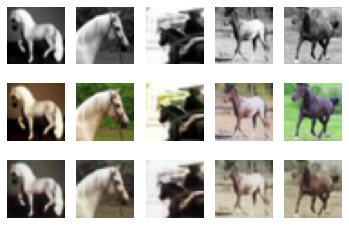

38 tensor(0.0036)
Loss:tensor(0.0036, device='cuda:0', grad_fn=<MseLossBackward0>)


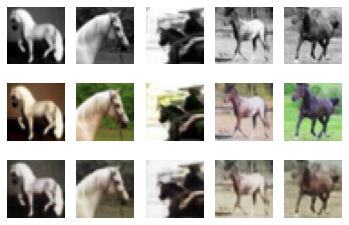

39 tensor(0.0036)
Loss:tensor(0.0036, device='cuda:0', grad_fn=<MseLossBackward0>)


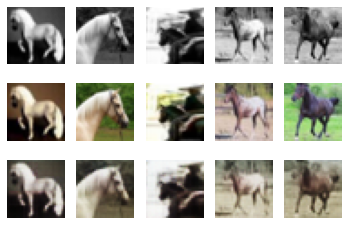

40 tensor(0.0035)
Loss:tensor(0.0035, device='cuda:0', grad_fn=<MseLossBackward0>)


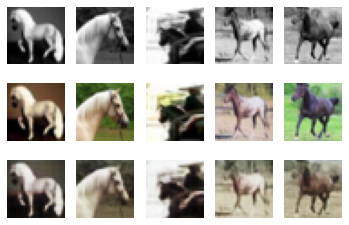

41 tensor(0.0035)
Loss:tensor(0.0035, device='cuda:0', grad_fn=<MseLossBackward0>)


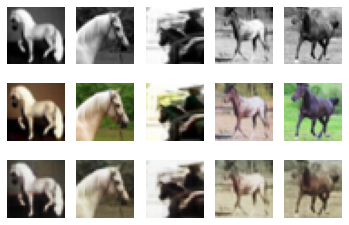

42 tensor(0.0034)
Loss:tensor(0.0034, device='cuda:0', grad_fn=<MseLossBackward0>)


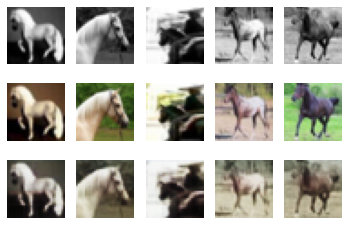

43 tensor(0.0034)
Loss:tensor(0.0034, device='cuda:0', grad_fn=<MseLossBackward0>)


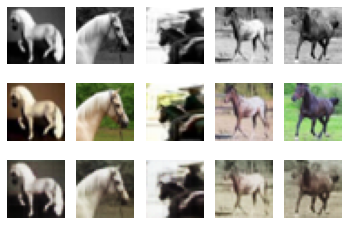

44 tensor(0.0034)
Loss:tensor(0.0034, device='cuda:0', grad_fn=<MseLossBackward0>)


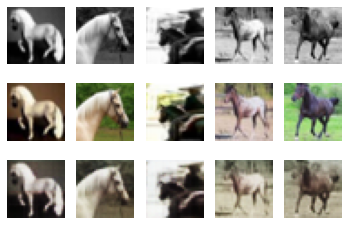

45 tensor(0.0034)
Loss:tensor(0.0034, device='cuda:0', grad_fn=<MseLossBackward0>)


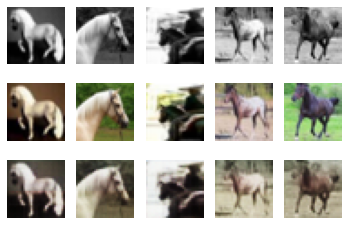

46 tensor(0.0035)
Loss:tensor(0.0035, device='cuda:0', grad_fn=<MseLossBackward0>)


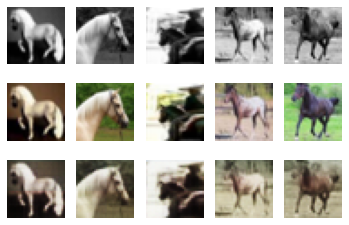

47 tensor(0.0034)
Loss:tensor(0.0034, device='cuda:0', grad_fn=<MseLossBackward0>)


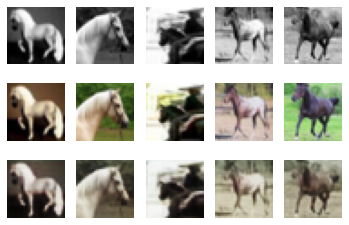

48 tensor(0.0033)
Loss:tensor(0.0033, device='cuda:0', grad_fn=<MseLossBackward0>)


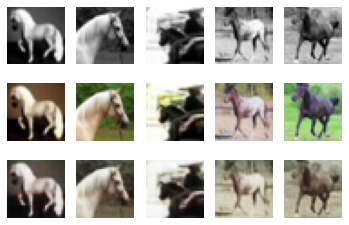

49 tensor(0.0033)
Loss:tensor(0.0033, device='cuda:0', grad_fn=<MseLossBackward0>)


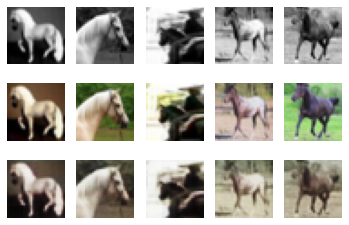

50 tensor(0.0033)
Loss:tensor(0.0033, device='cuda:0', grad_fn=<MseLossBackward0>)


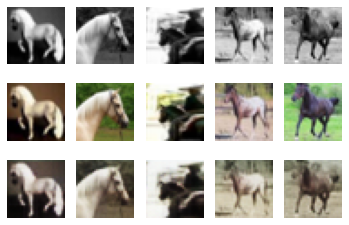

51 tensor(0.0032)
Loss:tensor(0.0032, device='cuda:0', grad_fn=<MseLossBackward0>)


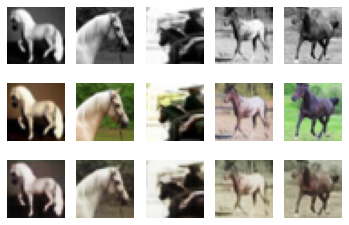

52 tensor(0.0031)
Loss:tensor(0.0031, device='cuda:0', grad_fn=<MseLossBackward0>)


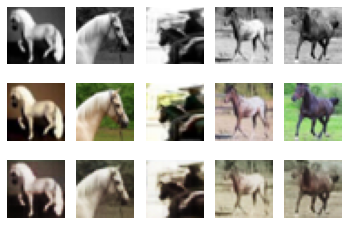

53 tensor(0.0031)
Loss:tensor(0.0031, device='cuda:0', grad_fn=<MseLossBackward0>)


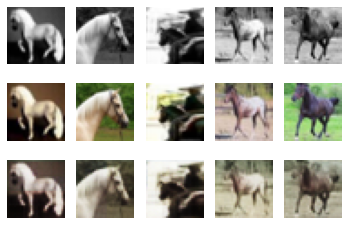

54 tensor(0.0031)
Loss:tensor(0.0031, device='cuda:0', grad_fn=<MseLossBackward0>)


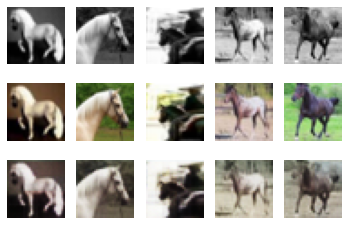

55 tensor(0.0031)
Loss:tensor(0.0031, device='cuda:0', grad_fn=<MseLossBackward0>)


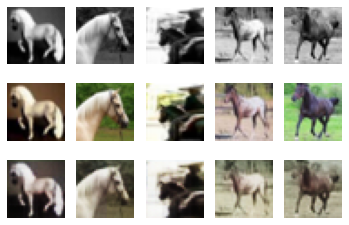

56 tensor(0.0031)
Loss:tensor(0.0031, device='cuda:0', grad_fn=<MseLossBackward0>)


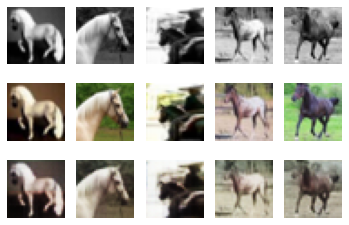

57 tensor(0.0031)
Loss:tensor(0.0031, device='cuda:0', grad_fn=<MseLossBackward0>)


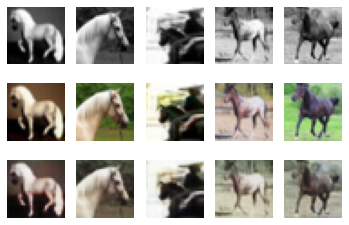

58 tensor(0.0030)
Loss:tensor(0.0030, device='cuda:0', grad_fn=<MseLossBackward0>)


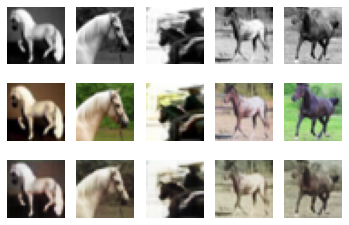

59 tensor(0.0029)
Loss:tensor(0.0029, device='cuda:0', grad_fn=<MseLossBackward0>)


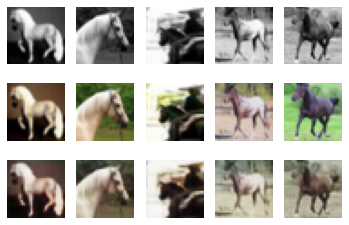

60 tensor(0.0030)
Loss:tensor(0.0030, device='cuda:0', grad_fn=<MseLossBackward0>)


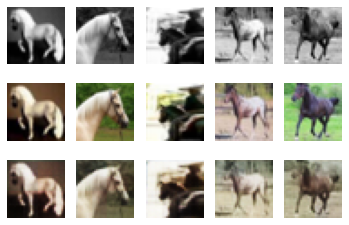

61 tensor(0.0028)
Loss:tensor(0.0028, device='cuda:0', grad_fn=<MseLossBackward0>)


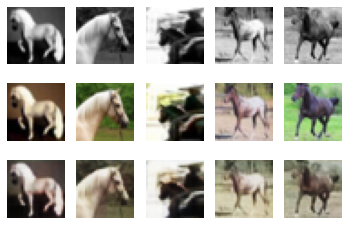

62 tensor(0.0027)
Loss:tensor(0.0027, device='cuda:0', grad_fn=<MseLossBackward0>)


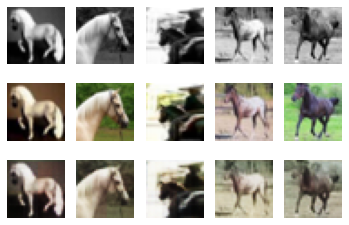

63 tensor(0.0027)
Loss:tensor(0.0027, device='cuda:0', grad_fn=<MseLossBackward0>)


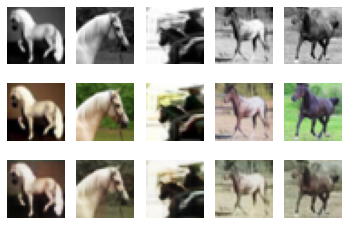

64 tensor(0.0027)
Loss:tensor(0.0027, device='cuda:0', grad_fn=<MseLossBackward0>)


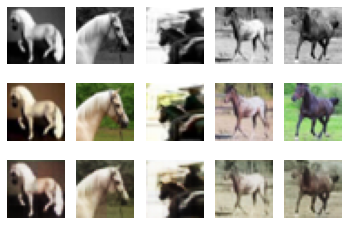

65 tensor(0.0029)
Loss:tensor(0.0029, device='cuda:0', grad_fn=<MseLossBackward0>)


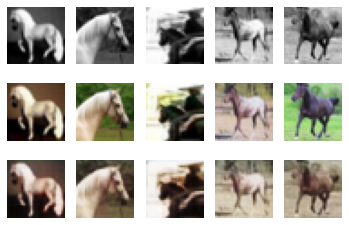

66 tensor(0.0027)
Loss:tensor(0.0027, device='cuda:0', grad_fn=<MseLossBackward0>)


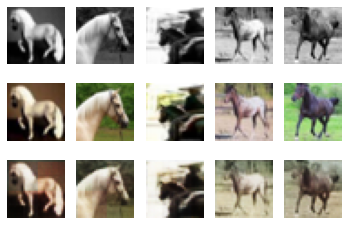

67 tensor(0.0026)
Loss:tensor(0.0026, device='cuda:0', grad_fn=<MseLossBackward0>)


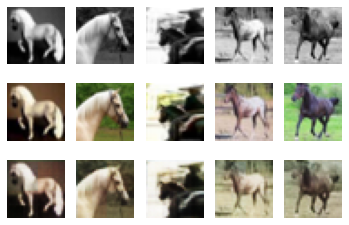

68 tensor(0.0025)
Loss:tensor(0.0025, device='cuda:0', grad_fn=<MseLossBackward0>)


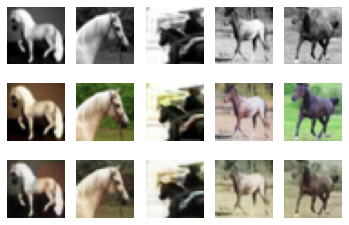

69 tensor(0.0026)
Loss:tensor(0.0026, device='cuda:0', grad_fn=<MseLossBackward0>)


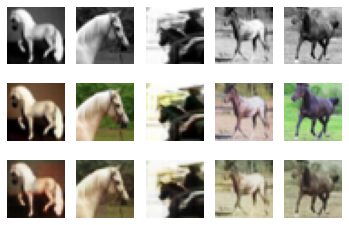

70 tensor(0.0025)
Loss:tensor(0.0025, device='cuda:0', grad_fn=<MseLossBackward0>)


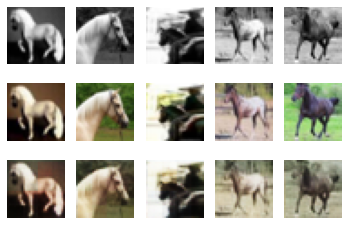

71 tensor(0.0025)
Loss:tensor(0.0025, device='cuda:0', grad_fn=<MseLossBackward0>)


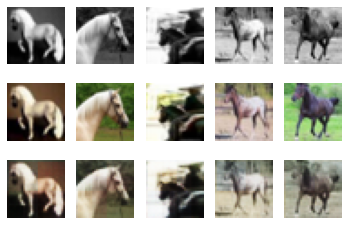

72 tensor(0.0024)
Loss:tensor(0.0024, device='cuda:0', grad_fn=<MseLossBackward0>)


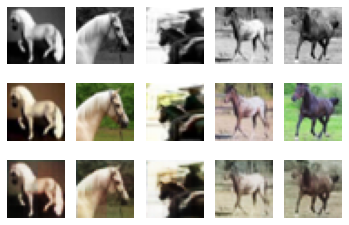

73 tensor(0.0023)
Loss:tensor(0.0023, device='cuda:0', grad_fn=<MseLossBackward0>)


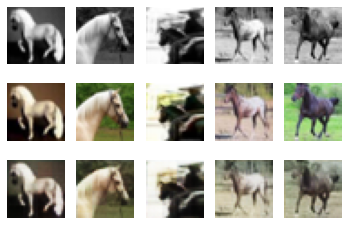

74 tensor(0.0025)
Loss:tensor(0.0025, device='cuda:0', grad_fn=<MseLossBackward0>)


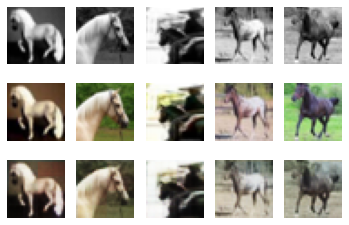

75 tensor(0.0024)
Loss:tensor(0.0024, device='cuda:0', grad_fn=<MseLossBackward0>)


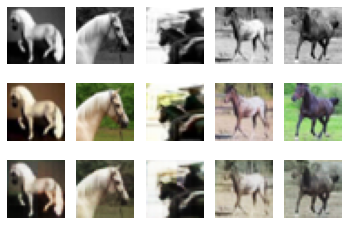

76 tensor(0.0023)
Loss:tensor(0.0023, device='cuda:0', grad_fn=<MseLossBackward0>)


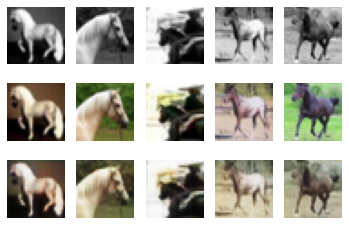

77 tensor(0.0022)
Loss:tensor(0.0022, device='cuda:0', grad_fn=<MseLossBackward0>)


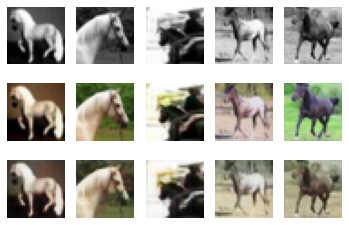

78 tensor(0.0021)
Loss:tensor(0.0021, device='cuda:0', grad_fn=<MseLossBackward0>)


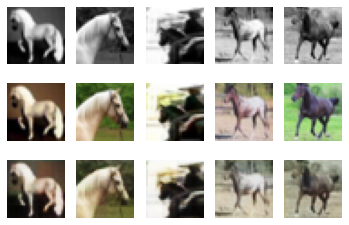

79 tensor(0.0022)
Loss:tensor(0.0022, device='cuda:0', grad_fn=<MseLossBackward0>)


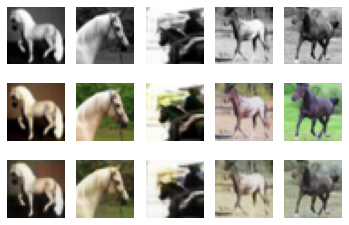

80 tensor(0.0022)
Loss:tensor(0.0022, device='cuda:0', grad_fn=<MseLossBackward0>)


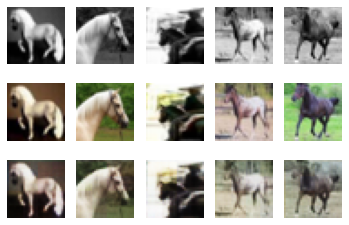

81 tensor(0.0021)
Loss:tensor(0.0021, device='cuda:0', grad_fn=<MseLossBackward0>)


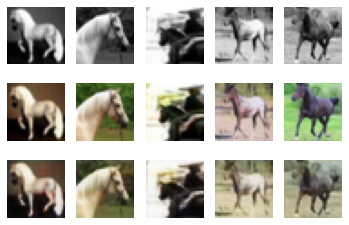

82 tensor(0.0021)
Loss:tensor(0.0021, device='cuda:0', grad_fn=<MseLossBackward0>)


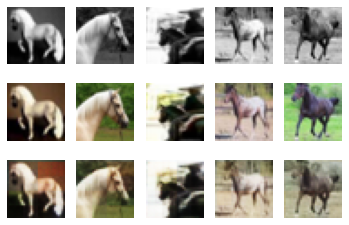

83 tensor(0.0020)
Loss:tensor(0.0020, device='cuda:0', grad_fn=<MseLossBackward0>)


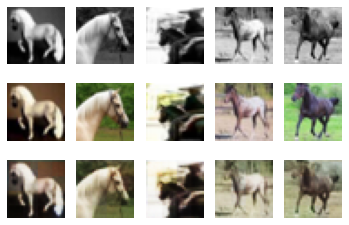

84 tensor(0.0021)
Loss:tensor(0.0021, device='cuda:0', grad_fn=<MseLossBackward0>)


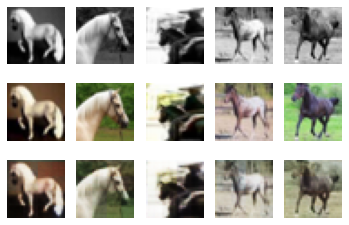

85 tensor(0.0019)
Loss:tensor(0.0019, device='cuda:0', grad_fn=<MseLossBackward0>)


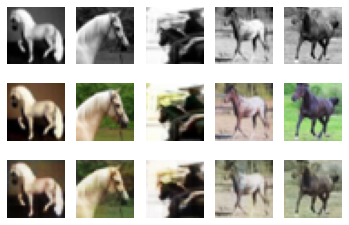

86 tensor(0.0019)
Loss:tensor(0.0019, device='cuda:0', grad_fn=<MseLossBackward0>)


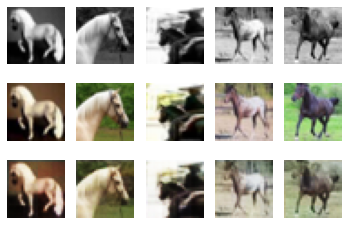

87 tensor(0.0020)
Loss:tensor(0.0020, device='cuda:0', grad_fn=<MseLossBackward0>)


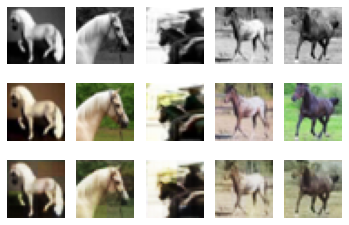

88 tensor(0.0019)
Loss:tensor(0.0019, device='cuda:0', grad_fn=<MseLossBackward0>)


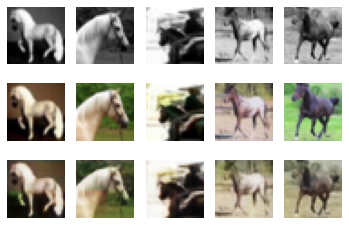

89 tensor(0.0022)
Loss:tensor(0.0022, device='cuda:0', grad_fn=<MseLossBackward0>)


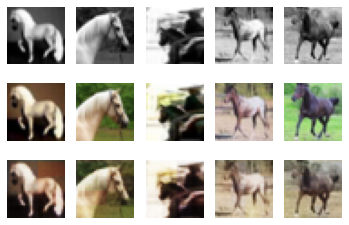

90 tensor(0.0021)
Loss:tensor(0.0021, device='cuda:0', grad_fn=<MseLossBackward0>)


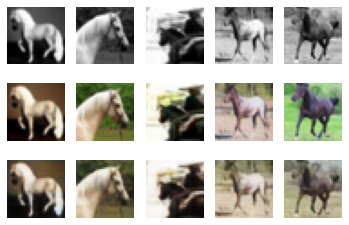

91 tensor(0.0020)
Loss:tensor(0.0020, device='cuda:0', grad_fn=<MseLossBackward0>)


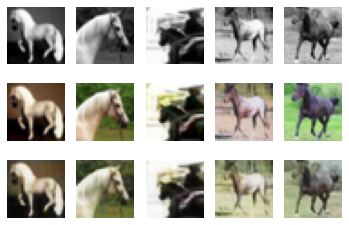

92 tensor(0.0021)
Loss:tensor(0.0021, device='cuda:0', grad_fn=<MseLossBackward0>)


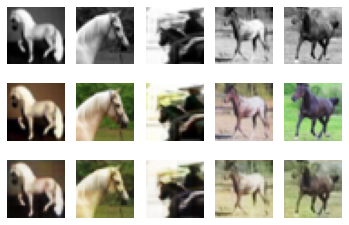

93 tensor(0.0020)
Loss:tensor(0.0020, device='cuda:0', grad_fn=<MseLossBackward0>)


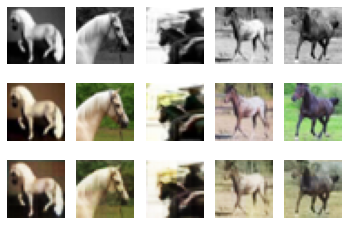

94 tensor(0.0021)
Loss:tensor(0.0021, device='cuda:0', grad_fn=<MseLossBackward0>)


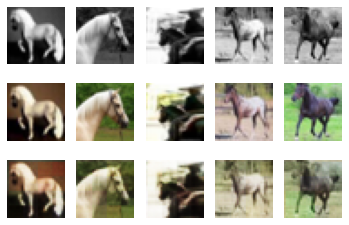

95 tensor(0.0020)
Loss:tensor(0.0020, device='cuda:0', grad_fn=<MseLossBackward0>)


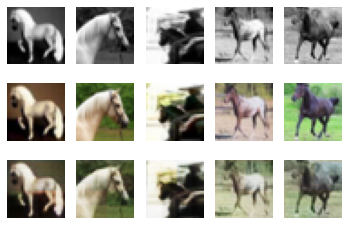

96 tensor(0.0023)
Loss:tensor(0.0023, device='cuda:0', grad_fn=<MseLossBackward0>)


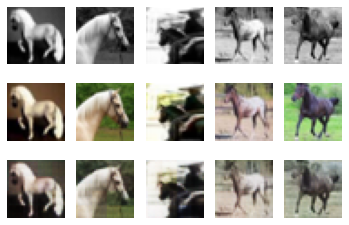

97 tensor(0.0020)
Loss:tensor(0.0020, device='cuda:0', grad_fn=<MseLossBackward0>)


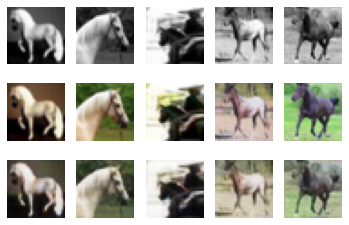

98 tensor(0.0018)
Loss:tensor(0.0018, device='cuda:0', grad_fn=<MseLossBackward0>)


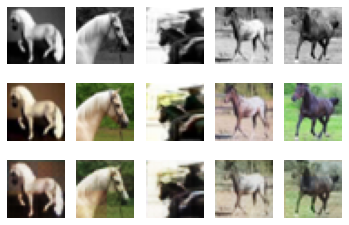

99 tensor(0.0017)
Loss:tensor(0.0017, device='cuda:0', grad_fn=<MseLossBackward0>)


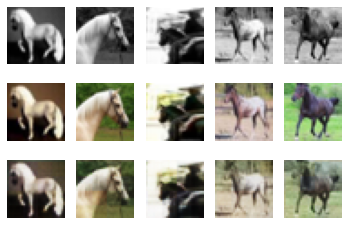

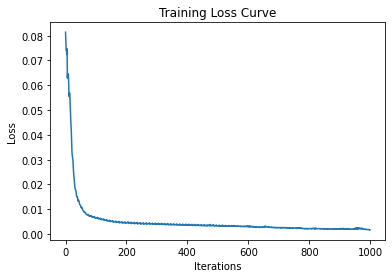

Final Loss: 0.0016797580756247044
Total time elapsed: 124.35 seconds


In [ ]:
# Main training loop for UNet
args = AttrDict()
args_dict = {
    "gpu": True,
    "valid": False,
    "checkpoint": "",
    "colours": "./data/colours/colour_kmeans24_cat7.npy",
    "model": "UNet",
    "kernel": 2,
    "num_filters": 32,
    'learn_rate':0.001, 
    "batch_size": 500,
    "epochs": 100,
    "seed": 0,
    "plot": True,
    "experiment_name": "colourization_Unet",
    "visualize": False,
    "downsize_input": False,
}
args.update(args_dict)
cnn = train(args)

**Answer**

At first it produced very bad predictions maybe because it was averaging over too many images however with time the color predictions improved but the predictions wren't as good as last time. Loss is also abit higher than last time 0.0016. This maybe because since we are averaging over 500 images the weights are not updating too much and so training takes time and loss is higher with same number of epochs. 

Batchsize: 50, epoch: 100

Loading data...
File path: data/cifar-10-batches-py.tar.gz
Transforming data...
Beginning training ...
0 tensor(0.0076)
Loss:tensor(0.0076, device='cuda:0', grad_fn=<MseLossBackward0>)


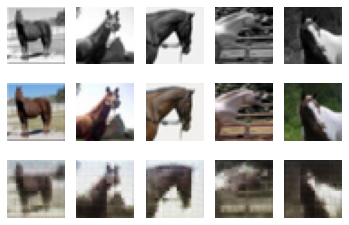

1 tensor(0.0051)
Loss:tensor(0.0051, device='cuda:0', grad_fn=<MseLossBackward0>)


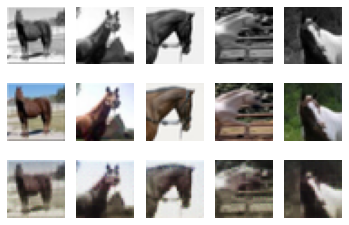

2 tensor(0.0044)
Loss:tensor(0.0044, device='cuda:0', grad_fn=<MseLossBackward0>)


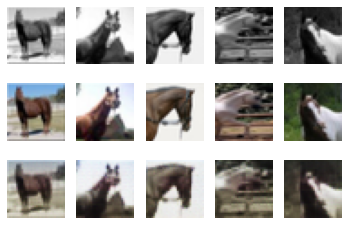

3 tensor(0.0041)
Loss:tensor(0.0041, device='cuda:0', grad_fn=<MseLossBackward0>)


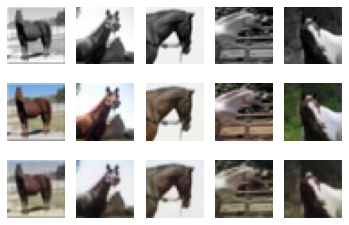

4 tensor(0.0039)
Loss:tensor(0.0039, device='cuda:0', grad_fn=<MseLossBackward0>)


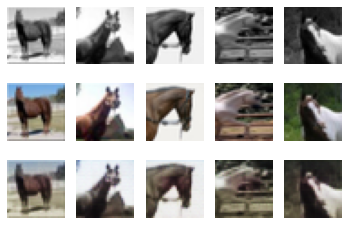

5 tensor(0.0037)
Loss:tensor(0.0037, device='cuda:0', grad_fn=<MseLossBackward0>)


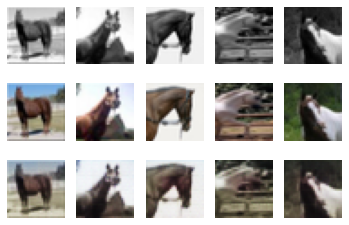

6 tensor(0.0036)
Loss:tensor(0.0036, device='cuda:0', grad_fn=<MseLossBackward0>)


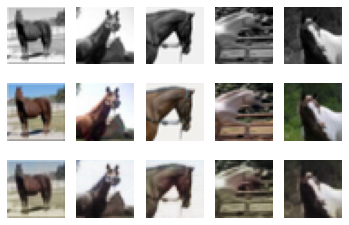

7 tensor(0.0035)
Loss:tensor(0.0035, device='cuda:0', grad_fn=<MseLossBackward0>)


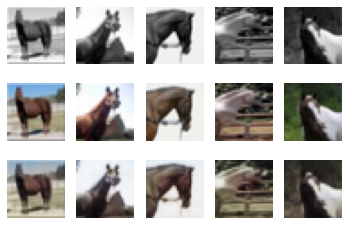

8 tensor(0.0035)
Loss:tensor(0.0035, device='cuda:0', grad_fn=<MseLossBackward0>)


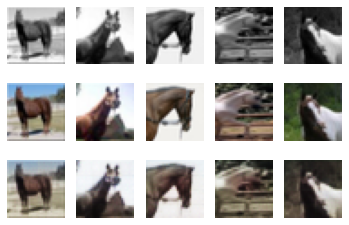

9 tensor(0.0035)
Loss:tensor(0.0035, device='cuda:0', grad_fn=<MseLossBackward0>)


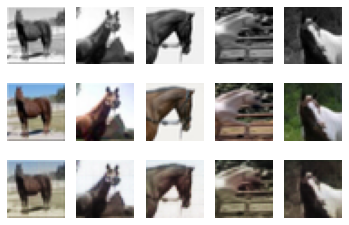

10 tensor(0.0034)
Loss:tensor(0.0034, device='cuda:0', grad_fn=<MseLossBackward0>)


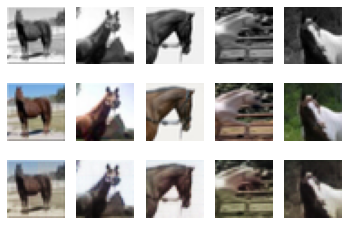

11 tensor(0.0033)
Loss:tensor(0.0033, device='cuda:0', grad_fn=<MseLossBackward0>)


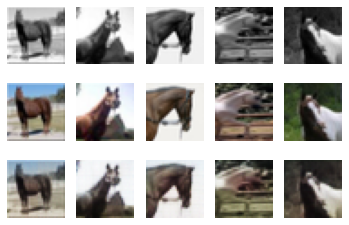

12 tensor(0.0032)
Loss:tensor(0.0032, device='cuda:0', grad_fn=<MseLossBackward0>)


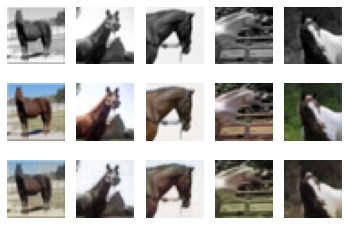

13 tensor(0.0031)
Loss:tensor(0.0031, device='cuda:0', grad_fn=<MseLossBackward0>)


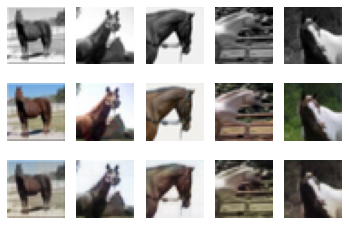

14 tensor(0.0029)
Loss:tensor(0.0029, device='cuda:0', grad_fn=<MseLossBackward0>)


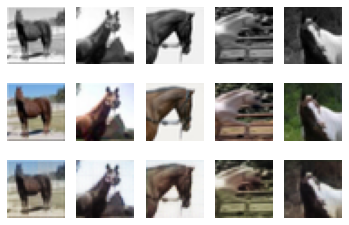

15 tensor(0.0030)
Loss:tensor(0.0030, device='cuda:0', grad_fn=<MseLossBackward0>)


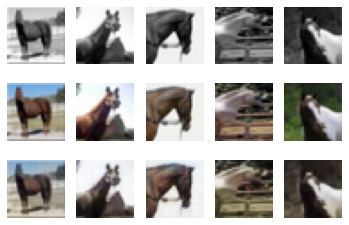

16 tensor(0.0031)
Loss:tensor(0.0031, device='cuda:0', grad_fn=<MseLossBackward0>)


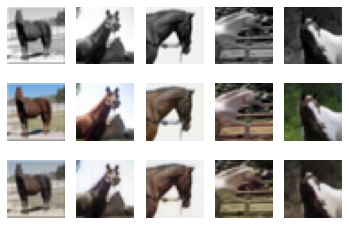

17 tensor(0.0029)
Loss:tensor(0.0029, device='cuda:0', grad_fn=<MseLossBackward0>)


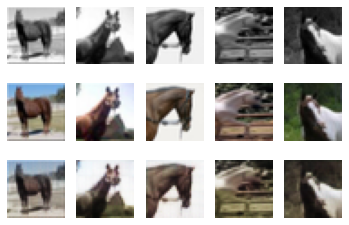

18 tensor(0.0029)
Loss:tensor(0.0029, device='cuda:0', grad_fn=<MseLossBackward0>)


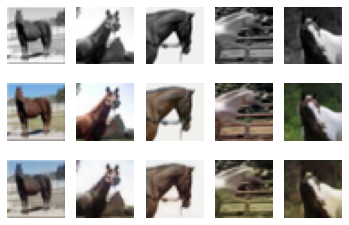

19 tensor(0.0028)
Loss:tensor(0.0028, device='cuda:0', grad_fn=<MseLossBackward0>)


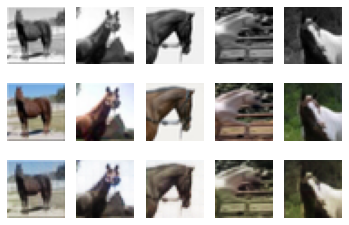

20 tensor(0.0026)
Loss:tensor(0.0026, device='cuda:0', grad_fn=<MseLossBackward0>)


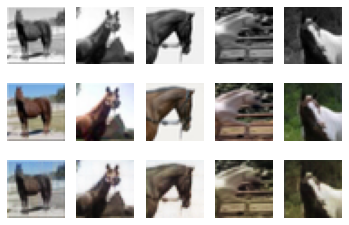

21 tensor(0.0024)
Loss:tensor(0.0024, device='cuda:0', grad_fn=<MseLossBackward0>)


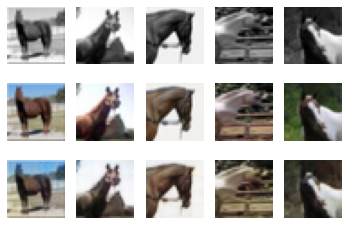

22 tensor(0.0025)
Loss:tensor(0.0025, device='cuda:0', grad_fn=<MseLossBackward0>)


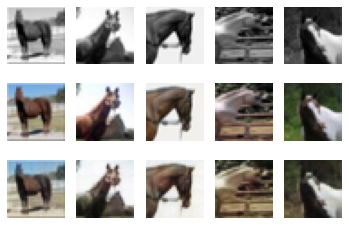

23 tensor(0.0025)
Loss:tensor(0.0025, device='cuda:0', grad_fn=<MseLossBackward0>)


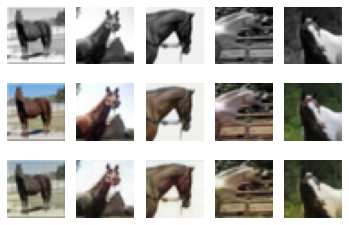

24 tensor(0.0023)
Loss:tensor(0.0023, device='cuda:0', grad_fn=<MseLossBackward0>)


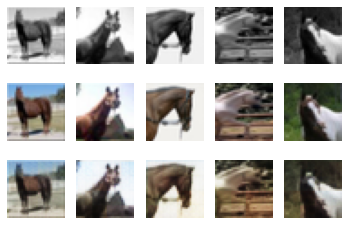

25 tensor(0.0022)
Loss:tensor(0.0022, device='cuda:0', grad_fn=<MseLossBackward0>)


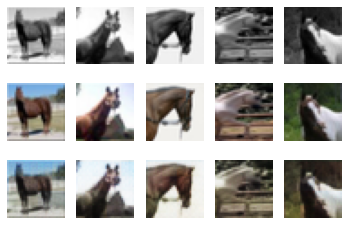

26 tensor(0.0021)
Loss:tensor(0.0021, device='cuda:0', grad_fn=<MseLossBackward0>)


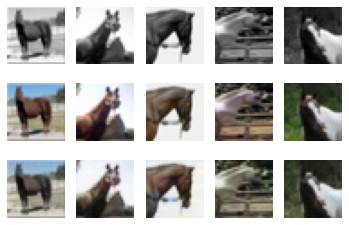

27 tensor(0.0020)
Loss:tensor(0.0020, device='cuda:0', grad_fn=<MseLossBackward0>)


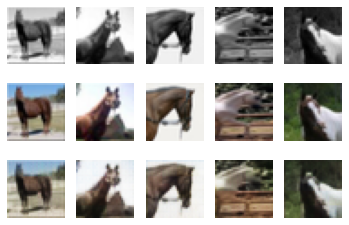

28 tensor(0.0020)
Loss:tensor(0.0020, device='cuda:0', grad_fn=<MseLossBackward0>)


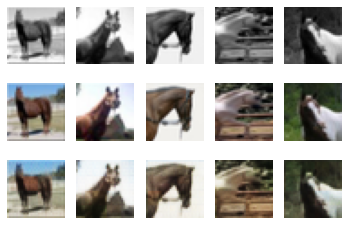

29 tensor(0.0019)
Loss:tensor(0.0019, device='cuda:0', grad_fn=<MseLossBackward0>)


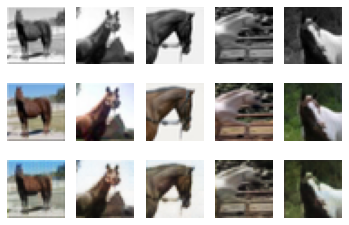

30 tensor(0.0018)
Loss:tensor(0.0018, device='cuda:0', grad_fn=<MseLossBackward0>)


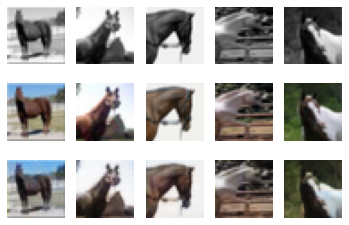

31 tensor(0.0022)
Loss:tensor(0.0022, device='cuda:0', grad_fn=<MseLossBackward0>)


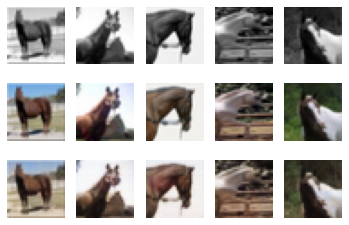

32 tensor(0.0018)
Loss:tensor(0.0018, device='cuda:0', grad_fn=<MseLossBackward0>)


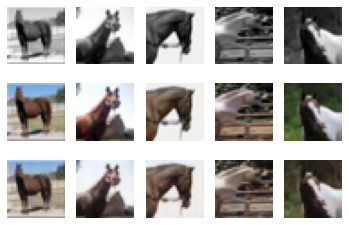

33 tensor(0.0017)
Loss:tensor(0.0017, device='cuda:0', grad_fn=<MseLossBackward0>)


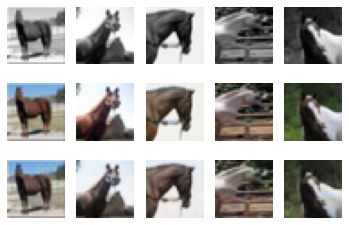

34 tensor(0.0016)
Loss:tensor(0.0016, device='cuda:0', grad_fn=<MseLossBackward0>)


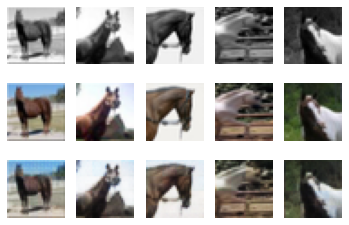

35 tensor(0.0016)
Loss:tensor(0.0016, device='cuda:0', grad_fn=<MseLossBackward0>)


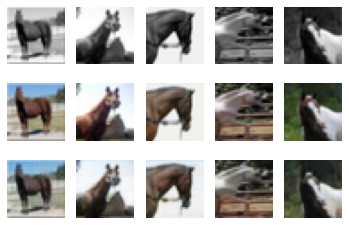

36 tensor(0.0016)
Loss:tensor(0.0016, device='cuda:0', grad_fn=<MseLossBackward0>)


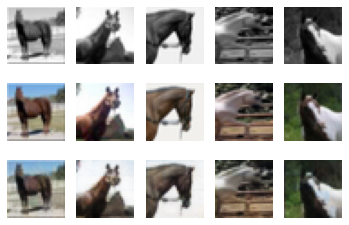

37 tensor(0.0016)
Loss:tensor(0.0016, device='cuda:0', grad_fn=<MseLossBackward0>)


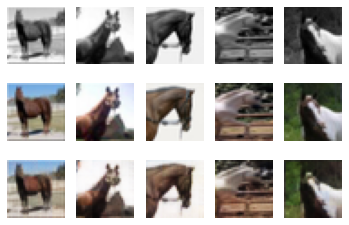

38 tensor(0.0016)
Loss:tensor(0.0016, device='cuda:0', grad_fn=<MseLossBackward0>)


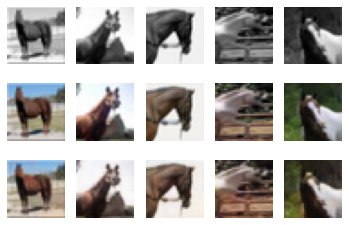

39 tensor(0.0013)
Loss:tensor(0.0013, device='cuda:0', grad_fn=<MseLossBackward0>)


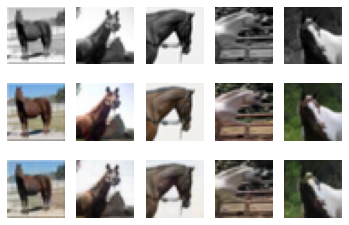

40 tensor(0.0012)
Loss:tensor(0.0012, device='cuda:0', grad_fn=<MseLossBackward0>)


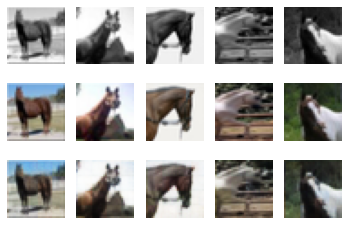

41 tensor(0.0013)
Loss:tensor(0.0013, device='cuda:0', grad_fn=<MseLossBackward0>)


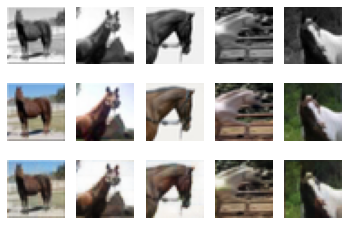

42 tensor(0.0012)
Loss:tensor(0.0012, device='cuda:0', grad_fn=<MseLossBackward0>)


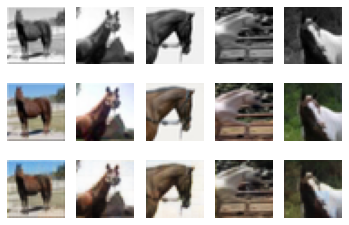

43 tensor(0.0012)
Loss:tensor(0.0012, device='cuda:0', grad_fn=<MseLossBackward0>)


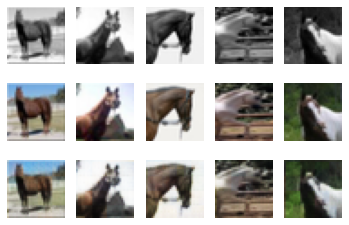

44 tensor(0.0014)
Loss:tensor(0.0014, device='cuda:0', grad_fn=<MseLossBackward0>)


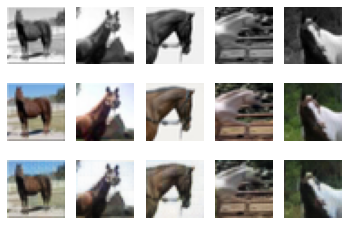

45 tensor(0.0013)
Loss:tensor(0.0013, device='cuda:0', grad_fn=<MseLossBackward0>)


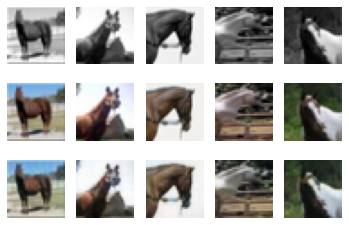

46 tensor(0.0012)
Loss:tensor(0.0012, device='cuda:0', grad_fn=<MseLossBackward0>)


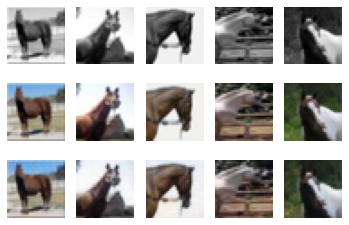

47 tensor(0.0010)
Loss:tensor(0.0010, device='cuda:0', grad_fn=<MseLossBackward0>)


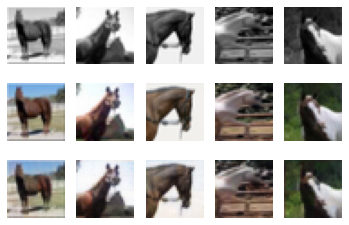

48 tensor(0.0010)
Loss:tensor(0.0010, device='cuda:0', grad_fn=<MseLossBackward0>)


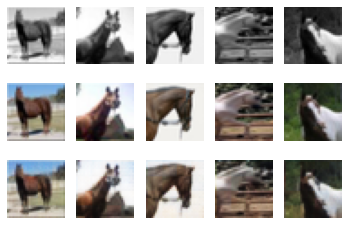

49 tensor(0.0013)
Loss:tensor(0.0013, device='cuda:0', grad_fn=<MseLossBackward0>)


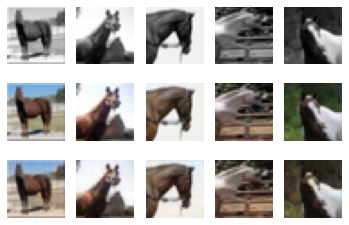

50 tensor(0.0014)
Loss:tensor(0.0014, device='cuda:0', grad_fn=<MseLossBackward0>)


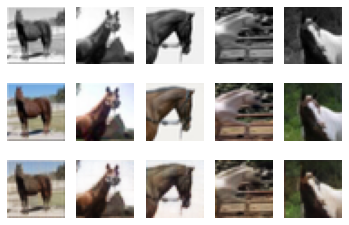

51 tensor(0.0012)
Loss:tensor(0.0012, device='cuda:0', grad_fn=<MseLossBackward0>)


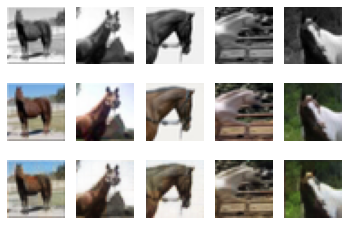

52 tensor(0.0011)
Loss:tensor(0.0011, device='cuda:0', grad_fn=<MseLossBackward0>)


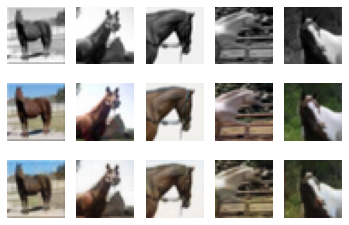

53 tensor(0.0013)
Loss:tensor(0.0013, device='cuda:0', grad_fn=<MseLossBackward0>)


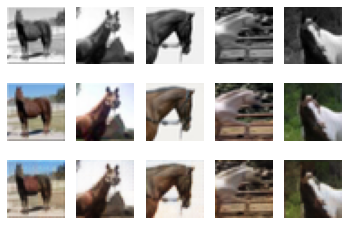

54 tensor(0.0013)
Loss:tensor(0.0013, device='cuda:0', grad_fn=<MseLossBackward0>)


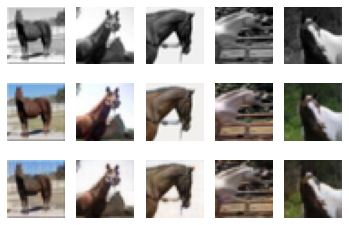

55 tensor(0.0011)
Loss:tensor(0.0011, device='cuda:0', grad_fn=<MseLossBackward0>)


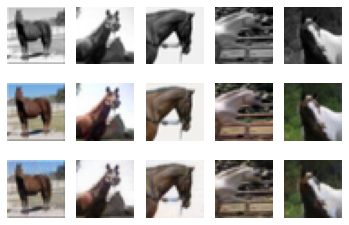

56 tensor(0.0012)
Loss:tensor(0.0012, device='cuda:0', grad_fn=<MseLossBackward0>)


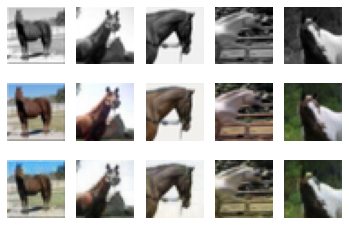

57 tensor(0.0011)
Loss:tensor(0.0011, device='cuda:0', grad_fn=<MseLossBackward0>)


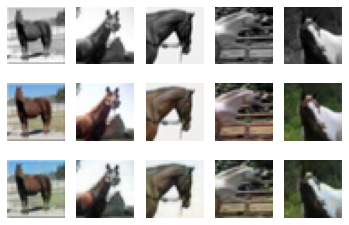

58 tensor(0.0010)
Loss:tensor(0.0010, device='cuda:0', grad_fn=<MseLossBackward0>)


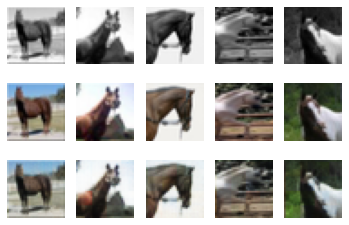

59 tensor(0.0010)
Loss:tensor(0.0010, device='cuda:0', grad_fn=<MseLossBackward0>)


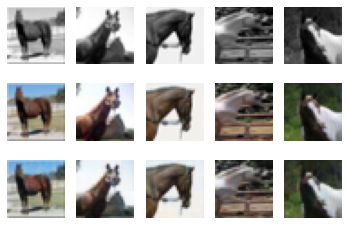

60 tensor(0.0010)
Loss:tensor(0.0010, device='cuda:0', grad_fn=<MseLossBackward0>)


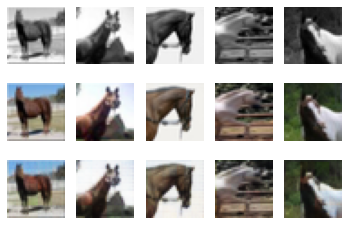

61 tensor(0.0011)
Loss:tensor(0.0011, device='cuda:0', grad_fn=<MseLossBackward0>)


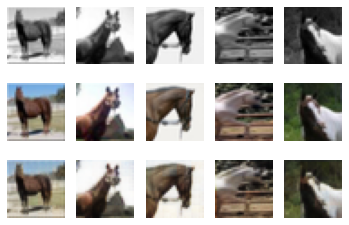

62 tensor(0.0010)
Loss:tensor(0.0010, device='cuda:0', grad_fn=<MseLossBackward0>)


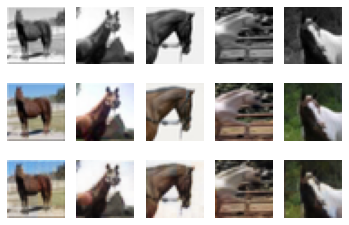

63 tensor(0.0009)
Loss:tensor(0.0009, device='cuda:0', grad_fn=<MseLossBackward0>)


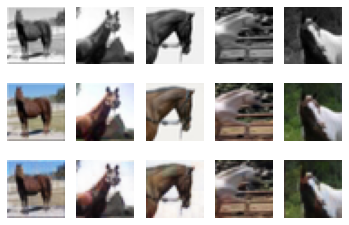

64 tensor(0.0010)
Loss:tensor(0.0010, device='cuda:0', grad_fn=<MseLossBackward0>)


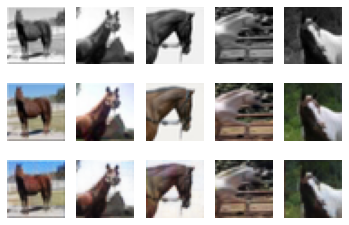

65 tensor(0.0009)
Loss:tensor(0.0009, device='cuda:0', grad_fn=<MseLossBackward0>)


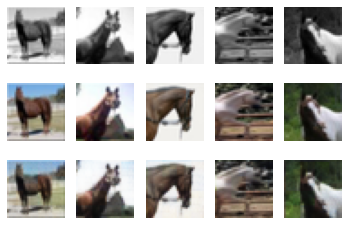

66 tensor(0.0009)
Loss:tensor(0.0009, device='cuda:0', grad_fn=<MseLossBackward0>)


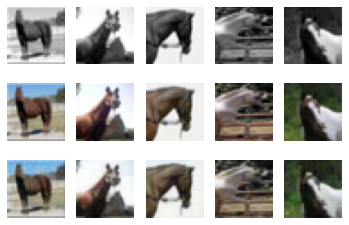

67 tensor(0.0013)
Loss:tensor(0.0013, device='cuda:0', grad_fn=<MseLossBackward0>)


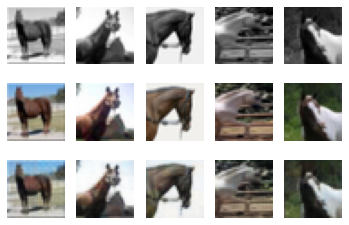

68 tensor(0.0011)
Loss:tensor(0.0011, device='cuda:0', grad_fn=<MseLossBackward0>)


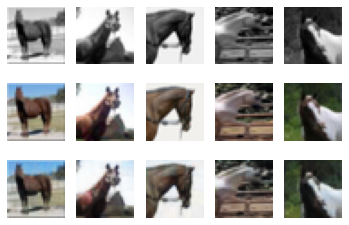

69 tensor(0.0009)
Loss:tensor(0.0009, device='cuda:0', grad_fn=<MseLossBackward0>)


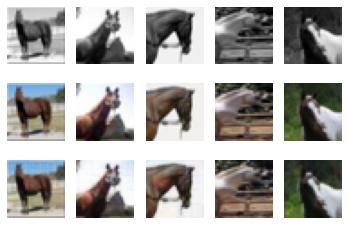

70 tensor(0.0008)
Loss:tensor(0.0008, device='cuda:0', grad_fn=<MseLossBackward0>)


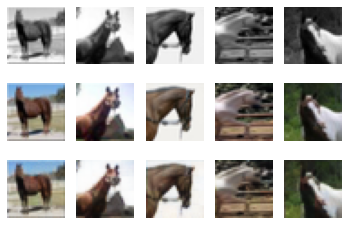

71 tensor(0.0009)
Loss:tensor(0.0009, device='cuda:0', grad_fn=<MseLossBackward0>)


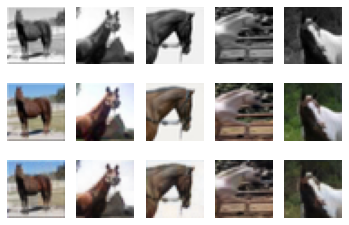

72 tensor(0.0009)
Loss:tensor(0.0009, device='cuda:0', grad_fn=<MseLossBackward0>)


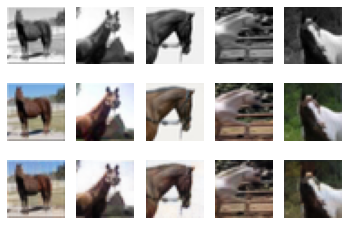

73 tensor(0.0010)
Loss:tensor(0.0010, device='cuda:0', grad_fn=<MseLossBackward0>)


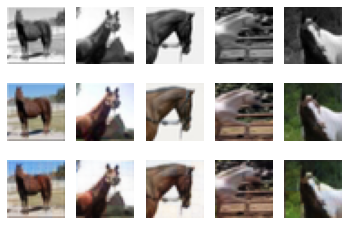

74 tensor(0.0009)
Loss:tensor(0.0009, device='cuda:0', grad_fn=<MseLossBackward0>)


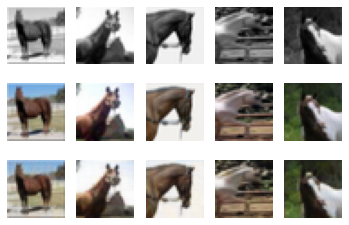

75 tensor(0.0009)
Loss:tensor(0.0009, device='cuda:0', grad_fn=<MseLossBackward0>)


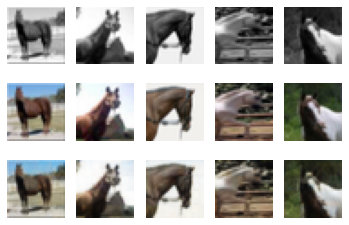

76 tensor(0.0009)
Loss:tensor(0.0009, device='cuda:0', grad_fn=<MseLossBackward0>)


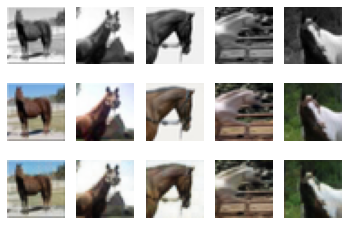

77 tensor(0.0008)
Loss:tensor(0.0008, device='cuda:0', grad_fn=<MseLossBackward0>)


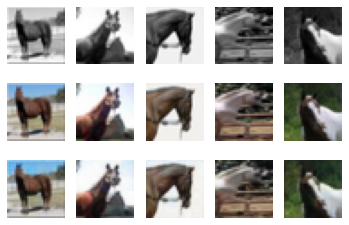

78 tensor(0.0008)
Loss:tensor(0.0008, device='cuda:0', grad_fn=<MseLossBackward0>)


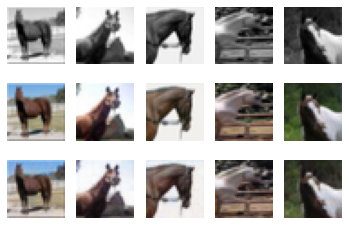

79 tensor(0.0011)
Loss:tensor(0.0011, device='cuda:0', grad_fn=<MseLossBackward0>)


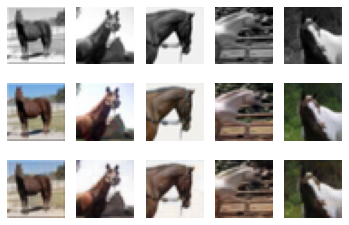

80 tensor(0.0011)
Loss:tensor(0.0011, device='cuda:0', grad_fn=<MseLossBackward0>)


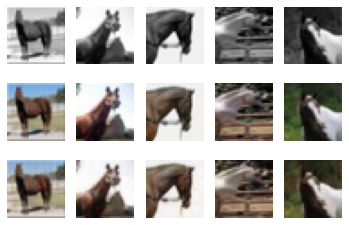

81 tensor(0.0009)
Loss:tensor(0.0009, device='cuda:0', grad_fn=<MseLossBackward0>)


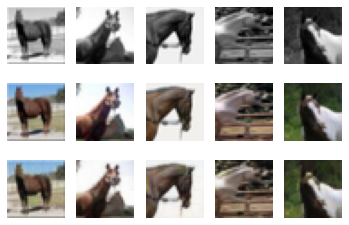

82 tensor(0.0008)
Loss:tensor(0.0008, device='cuda:0', grad_fn=<MseLossBackward0>)


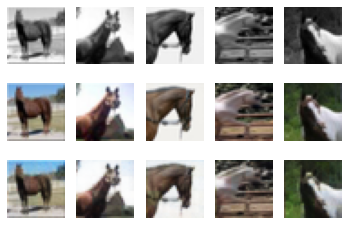

83 tensor(0.0010)
Loss:tensor(0.0010, device='cuda:0', grad_fn=<MseLossBackward0>)


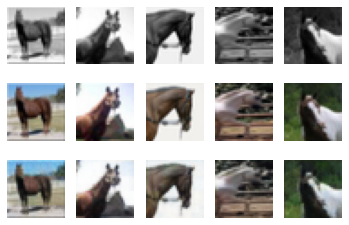

84 tensor(0.0010)
Loss:tensor(0.0010, device='cuda:0', grad_fn=<MseLossBackward0>)


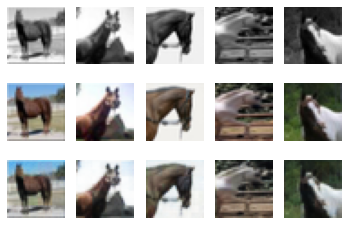

85 tensor(0.0009)
Loss:tensor(0.0009, device='cuda:0', grad_fn=<MseLossBackward0>)


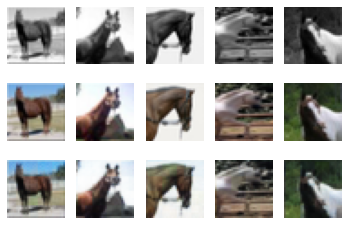

86 tensor(0.0008)
Loss:tensor(0.0008, device='cuda:0', grad_fn=<MseLossBackward0>)


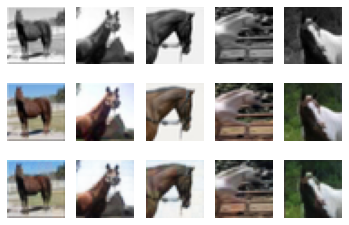

87 tensor(0.0009)
Loss:tensor(0.0009, device='cuda:0', grad_fn=<MseLossBackward0>)


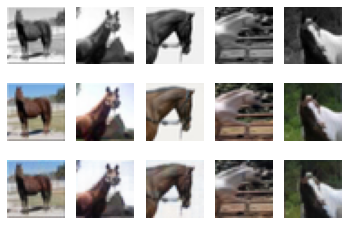

88 tensor(0.0010)
Loss:tensor(0.0010, device='cuda:0', grad_fn=<MseLossBackward0>)


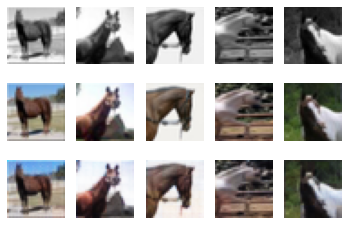

89 tensor(0.0010)
Loss:tensor(0.0010, device='cuda:0', grad_fn=<MseLossBackward0>)


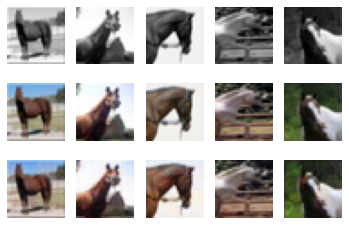

90 tensor(0.0010)
Loss:tensor(0.0010, device='cuda:0', grad_fn=<MseLossBackward0>)


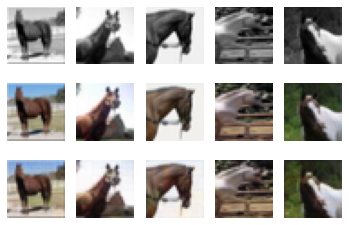

91 tensor(0.0009)
Loss:tensor(0.0009, device='cuda:0', grad_fn=<MseLossBackward0>)


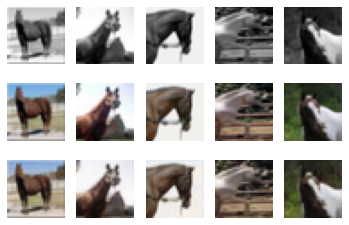

92 tensor(0.0008)
Loss:tensor(0.0008, device='cuda:0', grad_fn=<MseLossBackward0>)


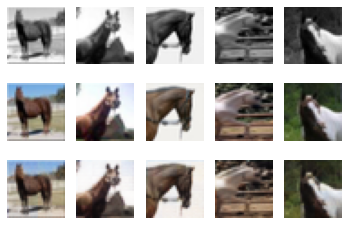

93 tensor(0.0008)
Loss:tensor(0.0008, device='cuda:0', grad_fn=<MseLossBackward0>)


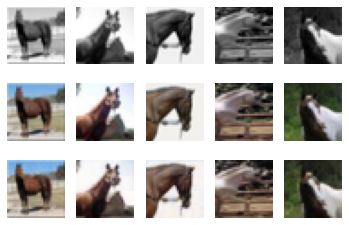

94 tensor(0.0007)
Loss:tensor(0.0007, device='cuda:0', grad_fn=<MseLossBackward0>)


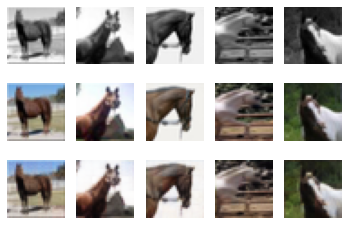

95 tensor(0.0007)
Loss:tensor(0.0007, device='cuda:0', grad_fn=<MseLossBackward0>)


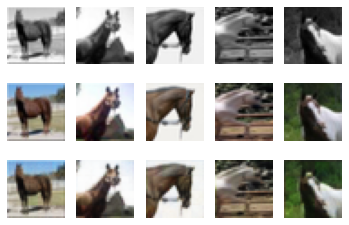

96 tensor(0.0007)
Loss:tensor(0.0007, device='cuda:0', grad_fn=<MseLossBackward0>)


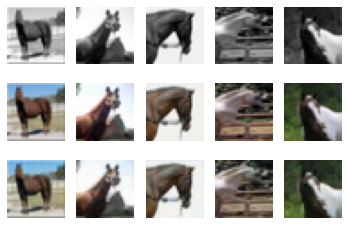

97 tensor(0.0009)
Loss:tensor(0.0009, device='cuda:0', grad_fn=<MseLossBackward0>)


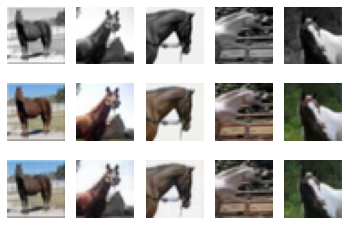

98 tensor(0.0011)
Loss:tensor(0.0011, device='cuda:0', grad_fn=<MseLossBackward0>)


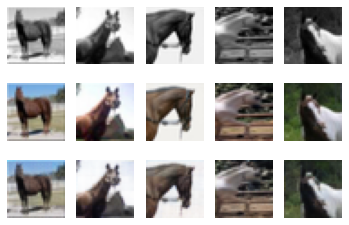

99 tensor(0.0007)
Loss:tensor(0.0007, device='cuda:0', grad_fn=<MseLossBackward0>)


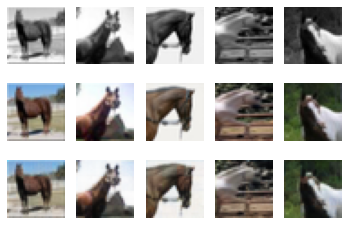

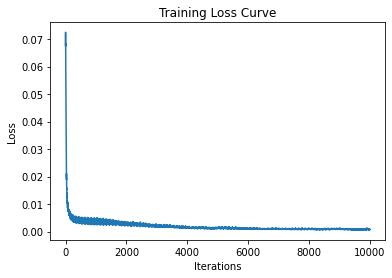

Final Loss: 0.0007256050012074411
Total time elapsed: 171.17 seconds


In [ ]:
# complete the code

# Main training loop for UNet
args = AttrDict()
args_dict = {
    "gpu": True,
    "valid": False,
    "checkpoint": "",
    "colours": "./data/colours/colour_kmeans24_cat7.npy",
    "model": "UNet",
    "kernel": 2,
    "num_filters": 32,
    'learn_rate':0.001, 
    "batch_size": 50,
    "epochs": 100,
    "seed": 0,
    "plot": True,
    "experiment_name": "colourization_Unet",
    "visualize": False,
    "downsize_input": False,
}
args.update(args_dict)
cnn = train(args)







**Answer**
Decresing the batch size to 50 seems to improve the predictions alot. The loss is also much lower 0.0007. However this could mean it is overfitting and hence won't to able to generalize on test images.

Batchsize: 2000, epoch: 100

Loading data...
File path: data/cifar-10-batches-py.tar.gz
Transforming data...
Beginning training ...
0 tensor(0.0619)
Loss:tensor(0.0619, device='cuda:0', grad_fn=<MseLossBackward0>)


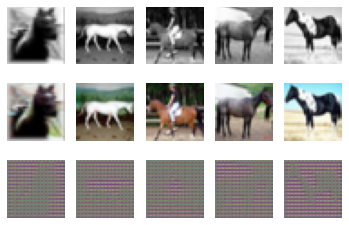

1 tensor(0.0573)
Loss:tensor(0.0573, device='cuda:0', grad_fn=<MseLossBackward0>)


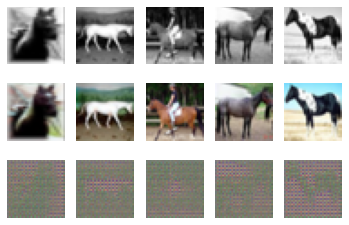

2 tensor(0.0516)
Loss:tensor(0.0516, device='cuda:0', grad_fn=<MseLossBackward0>)


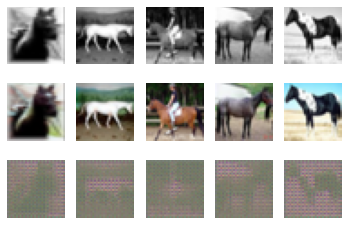

3 tensor(0.0436)
Loss:tensor(0.0436, device='cuda:0', grad_fn=<MseLossBackward0>)


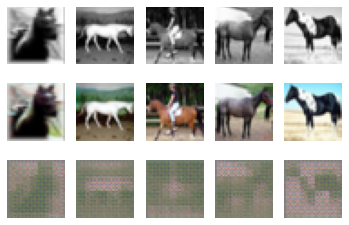

4 tensor(0.0364)
Loss:tensor(0.0364, device='cuda:0', grad_fn=<MseLossBackward0>)


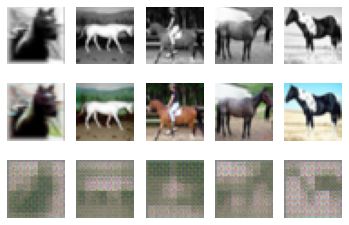

5 tensor(0.0285)
Loss:tensor(0.0285, device='cuda:0', grad_fn=<MseLossBackward0>)


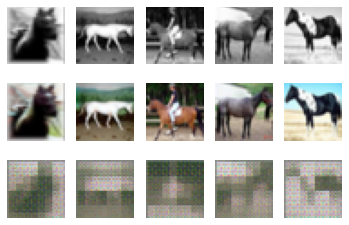

6 tensor(0.0282)
Loss:tensor(0.0282, device='cuda:0', grad_fn=<MseLossBackward0>)


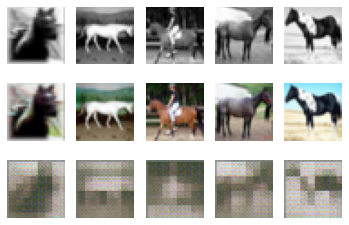

7 tensor(0.0247)
Loss:tensor(0.0247, device='cuda:0', grad_fn=<MseLossBackward0>)


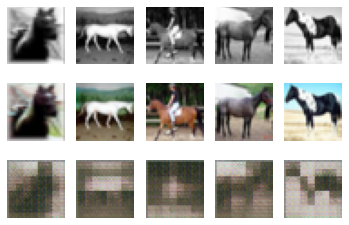

8 tensor(0.0219)
Loss:tensor(0.0219, device='cuda:0', grad_fn=<MseLossBackward0>)


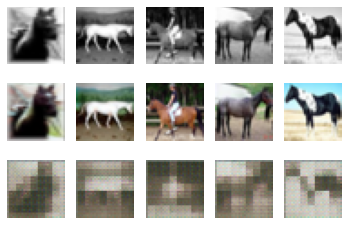

9 tensor(0.0193)
Loss:tensor(0.0193, device='cuda:0', grad_fn=<MseLossBackward0>)


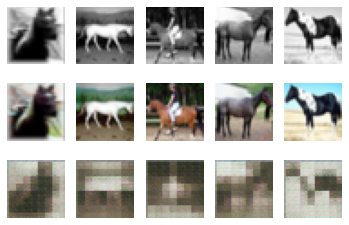

10 tensor(0.0180)
Loss:tensor(0.0180, device='cuda:0', grad_fn=<MseLossBackward0>)


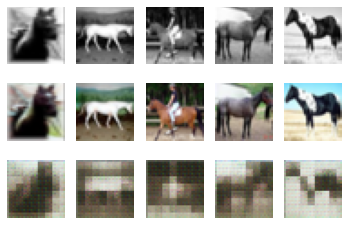

11 tensor(0.0164)
Loss:tensor(0.0164, device='cuda:0', grad_fn=<MseLossBackward0>)


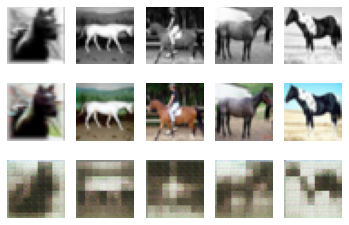

12 tensor(0.0151)
Loss:tensor(0.0151, device='cuda:0', grad_fn=<MseLossBackward0>)


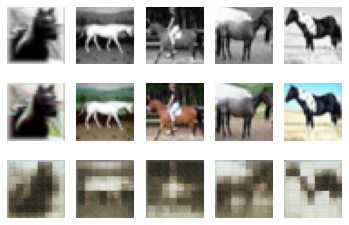

13 tensor(0.0141)
Loss:tensor(0.0141, device='cuda:0', grad_fn=<MseLossBackward0>)


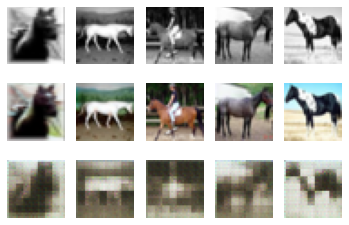

14 tensor(0.0132)
Loss:tensor(0.0132, device='cuda:0', grad_fn=<MseLossBackward0>)


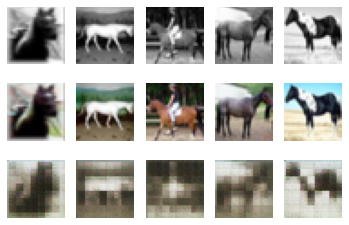

15 tensor(0.0123)
Loss:tensor(0.0123, device='cuda:0', grad_fn=<MseLossBackward0>)


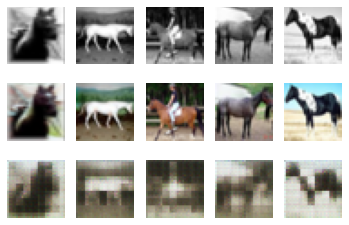

16 tensor(0.0116)
Loss:tensor(0.0116, device='cuda:0', grad_fn=<MseLossBackward0>)


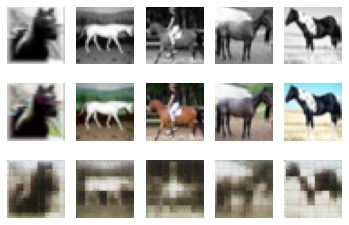

17 tensor(0.0109)
Loss:tensor(0.0109, device='cuda:0', grad_fn=<MseLossBackward0>)


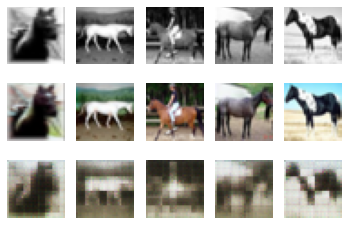

18 tensor(0.0103)
Loss:tensor(0.0103, device='cuda:0', grad_fn=<MseLossBackward0>)


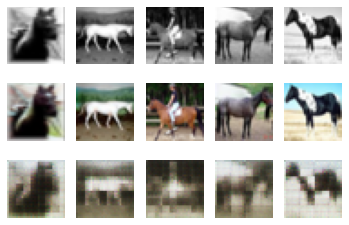

19 tensor(0.0097)
Loss:tensor(0.0097, device='cuda:0', grad_fn=<MseLossBackward0>)


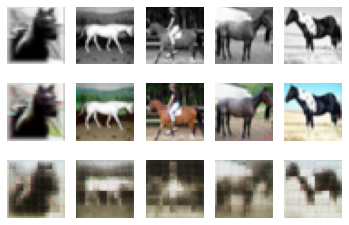

20 tensor(0.0093)
Loss:tensor(0.0093, device='cuda:0', grad_fn=<MseLossBackward0>)


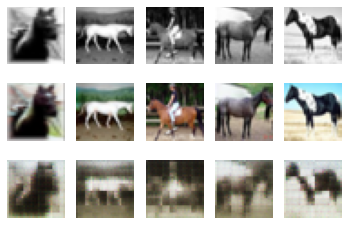

21 tensor(0.0088)
Loss:tensor(0.0088, device='cuda:0', grad_fn=<MseLossBackward0>)


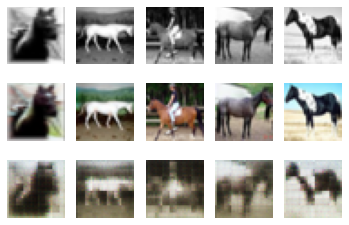

22 tensor(0.0085)
Loss:tensor(0.0085, device='cuda:0', grad_fn=<MseLossBackward0>)


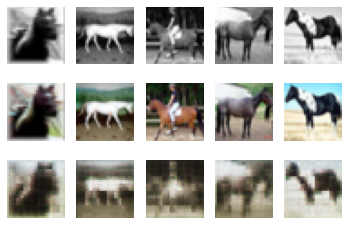

23 tensor(0.0082)
Loss:tensor(0.0082, device='cuda:0', grad_fn=<MseLossBackward0>)


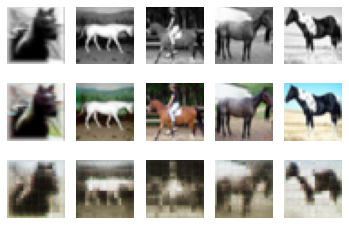

24 tensor(0.0080)
Loss:tensor(0.0080, device='cuda:0', grad_fn=<MseLossBackward0>)


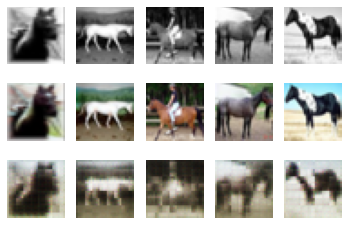

25 tensor(0.0077)
Loss:tensor(0.0077, device='cuda:0', grad_fn=<MseLossBackward0>)


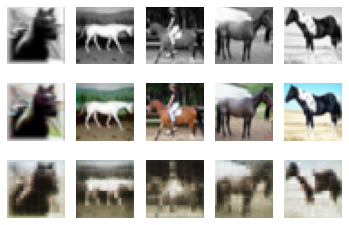

26 tensor(0.0076)
Loss:tensor(0.0076, device='cuda:0', grad_fn=<MseLossBackward0>)


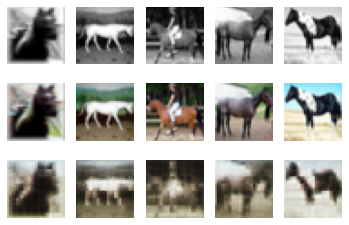

27 tensor(0.0074)
Loss:tensor(0.0074, device='cuda:0', grad_fn=<MseLossBackward0>)


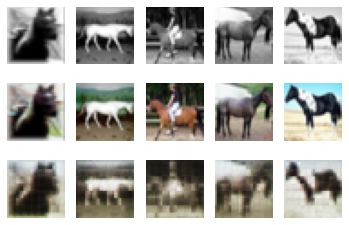

28 tensor(0.0072)
Loss:tensor(0.0072, device='cuda:0', grad_fn=<MseLossBackward0>)


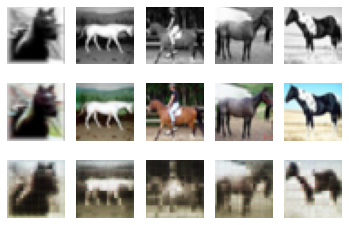

29 tensor(0.0071)
Loss:tensor(0.0071, device='cuda:0', grad_fn=<MseLossBackward0>)


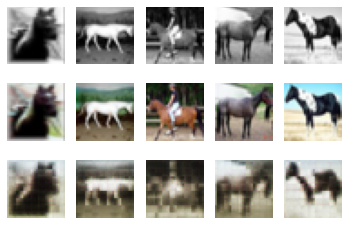

30 tensor(0.0070)
Loss:tensor(0.0070, device='cuda:0', grad_fn=<MseLossBackward0>)


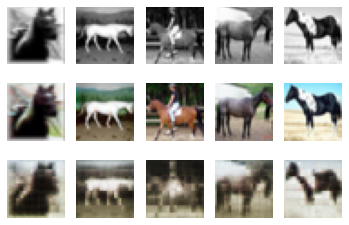

31 tensor(0.0068)
Loss:tensor(0.0068, device='cuda:0', grad_fn=<MseLossBackward0>)


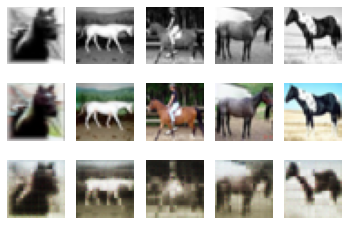

32 tensor(0.0067)
Loss:tensor(0.0067, device='cuda:0', grad_fn=<MseLossBackward0>)


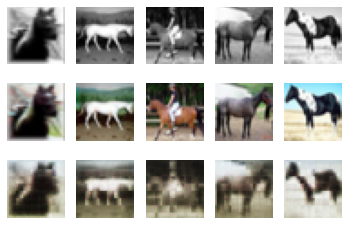

33 tensor(0.0066)
Loss:tensor(0.0066, device='cuda:0', grad_fn=<MseLossBackward0>)


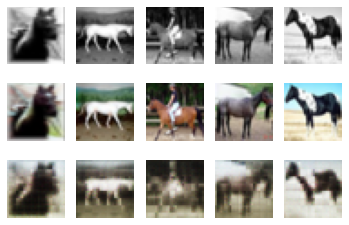

34 tensor(0.0064)
Loss:tensor(0.0064, device='cuda:0', grad_fn=<MseLossBackward0>)


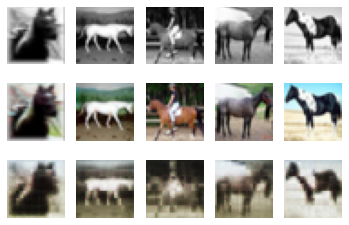

35 tensor(0.0063)
Loss:tensor(0.0063, device='cuda:0', grad_fn=<MseLossBackward0>)


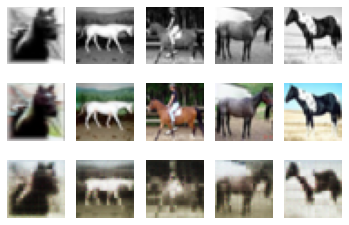

36 tensor(0.0062)
Loss:tensor(0.0062, device='cuda:0', grad_fn=<MseLossBackward0>)


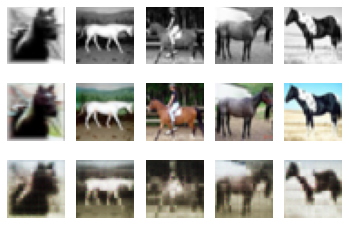

37 tensor(0.0060)
Loss:tensor(0.0060, device='cuda:0', grad_fn=<MseLossBackward0>)


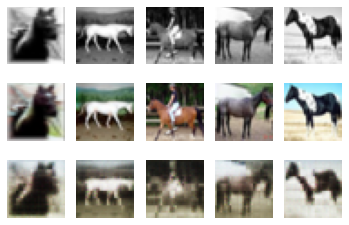

38 tensor(0.0059)
Loss:tensor(0.0059, device='cuda:0', grad_fn=<MseLossBackward0>)


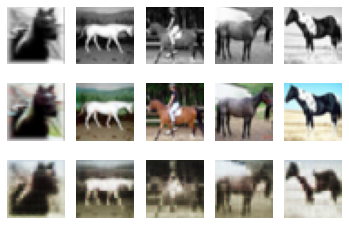

39 tensor(0.0059)
Loss:tensor(0.0059, device='cuda:0', grad_fn=<MseLossBackward0>)


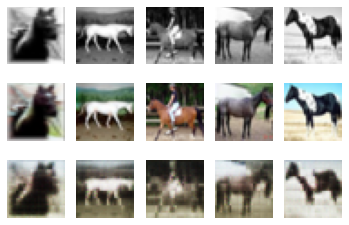

40 tensor(0.0060)
Loss:tensor(0.0060, device='cuda:0', grad_fn=<MseLossBackward0>)


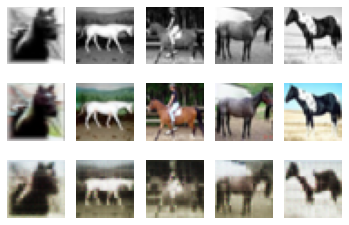

41 tensor(0.0057)
Loss:tensor(0.0057, device='cuda:0', grad_fn=<MseLossBackward0>)


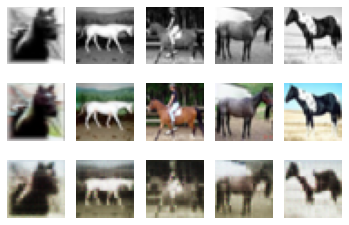

42 tensor(0.0055)
Loss:tensor(0.0055, device='cuda:0', grad_fn=<MseLossBackward0>)


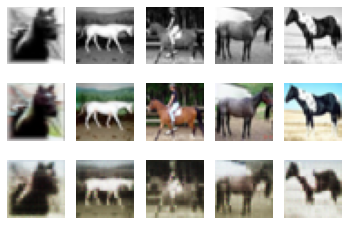

43 tensor(0.0054)
Loss:tensor(0.0054, device='cuda:0', grad_fn=<MseLossBackward0>)


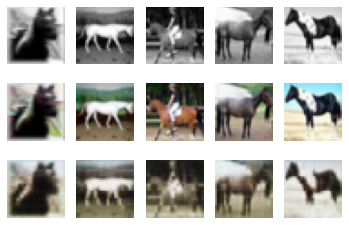

44 tensor(0.0053)
Loss:tensor(0.0053, device='cuda:0', grad_fn=<MseLossBackward0>)


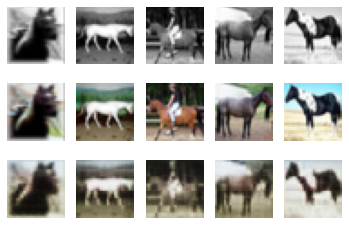

45 tensor(0.0053)
Loss:tensor(0.0053, device='cuda:0', grad_fn=<MseLossBackward0>)


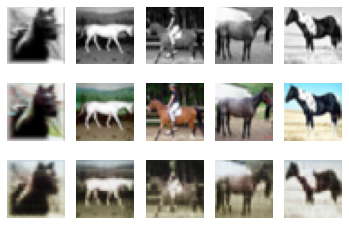

46 tensor(0.0052)
Loss:tensor(0.0052, device='cuda:0', grad_fn=<MseLossBackward0>)


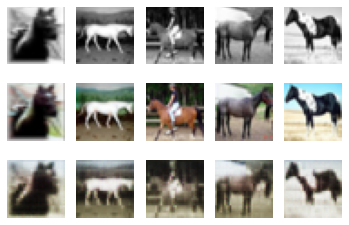

47 tensor(0.0051)
Loss:tensor(0.0051, device='cuda:0', grad_fn=<MseLossBackward0>)


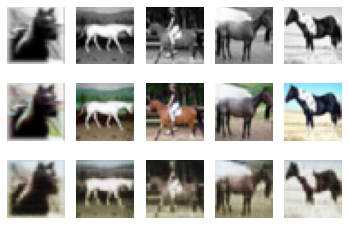

48 tensor(0.0050)
Loss:tensor(0.0050, device='cuda:0', grad_fn=<MseLossBackward0>)


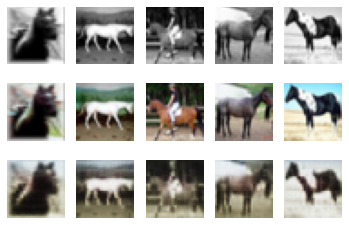

49 tensor(0.0049)
Loss:tensor(0.0049, device='cuda:0', grad_fn=<MseLossBackward0>)


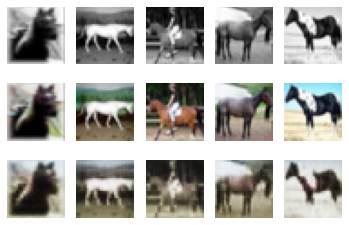

50 tensor(0.0049)
Loss:tensor(0.0049, device='cuda:0', grad_fn=<MseLossBackward0>)


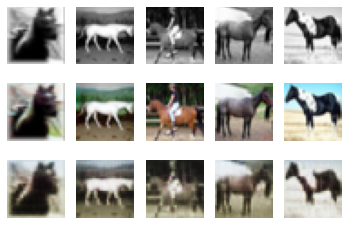

51 tensor(0.0048)
Loss:tensor(0.0048, device='cuda:0', grad_fn=<MseLossBackward0>)


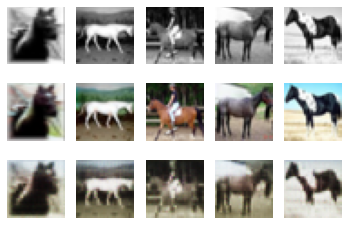

52 tensor(0.0047)
Loss:tensor(0.0047, device='cuda:0', grad_fn=<MseLossBackward0>)


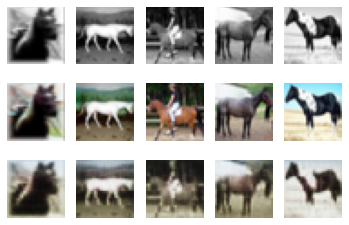

53 tensor(0.0047)
Loss:tensor(0.0047, device='cuda:0', grad_fn=<MseLossBackward0>)


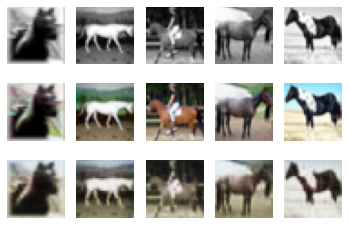

54 tensor(0.0047)
Loss:tensor(0.0047, device='cuda:0', grad_fn=<MseLossBackward0>)


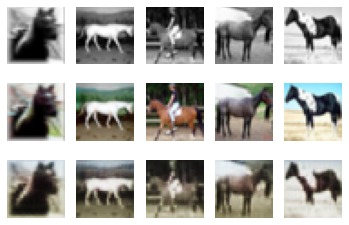

55 tensor(0.0047)
Loss:tensor(0.0047, device='cuda:0', grad_fn=<MseLossBackward0>)


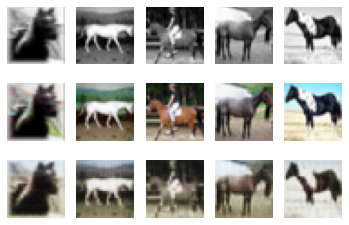

56 tensor(0.0046)
Loss:tensor(0.0046, device='cuda:0', grad_fn=<MseLossBackward0>)


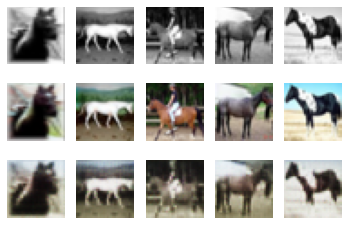

57 tensor(0.0046)
Loss:tensor(0.0046, device='cuda:0', grad_fn=<MseLossBackward0>)


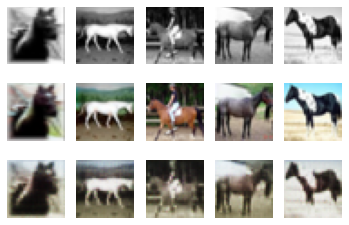

58 tensor(0.0045)
Loss:tensor(0.0045, device='cuda:0', grad_fn=<MseLossBackward0>)


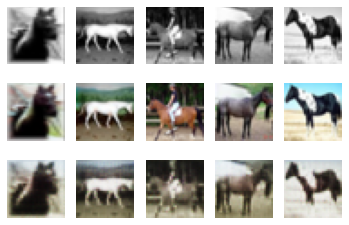

59 tensor(0.0045)
Loss:tensor(0.0045, device='cuda:0', grad_fn=<MseLossBackward0>)


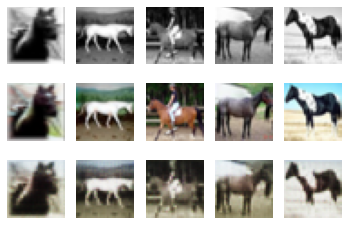

60 tensor(0.0044)
Loss:tensor(0.0044, device='cuda:0', grad_fn=<MseLossBackward0>)


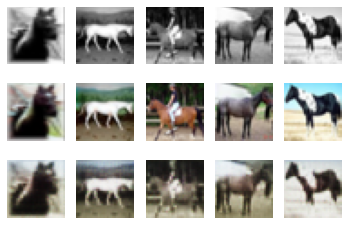

61 tensor(0.0044)
Loss:tensor(0.0044, device='cuda:0', grad_fn=<MseLossBackward0>)


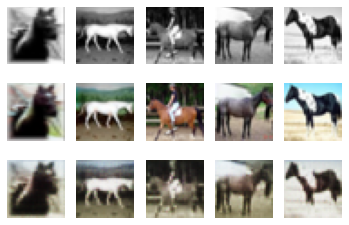

62 tensor(0.0043)
Loss:tensor(0.0043, device='cuda:0', grad_fn=<MseLossBackward0>)


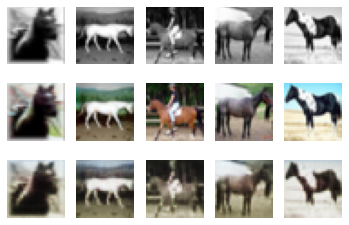

63 tensor(0.0043)
Loss:tensor(0.0043, device='cuda:0', grad_fn=<MseLossBackward0>)


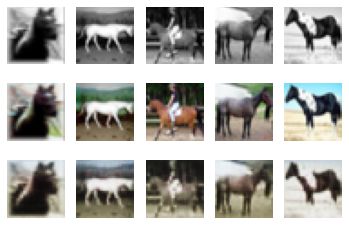

64 tensor(0.0044)
Loss:tensor(0.0044, device='cuda:0', grad_fn=<MseLossBackward0>)


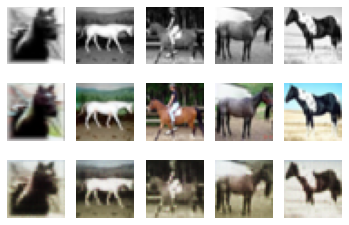

65 tensor(0.0043)
Loss:tensor(0.0043, device='cuda:0', grad_fn=<MseLossBackward0>)


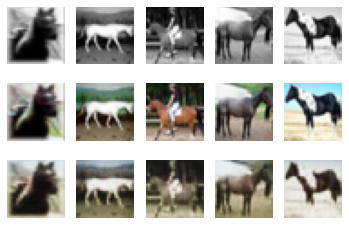

66 tensor(0.0042)
Loss:tensor(0.0042, device='cuda:0', grad_fn=<MseLossBackward0>)


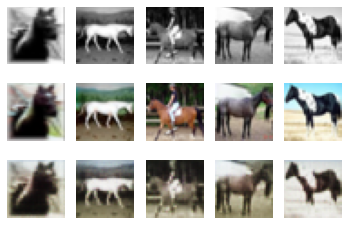

67 tensor(0.0042)
Loss:tensor(0.0042, device='cuda:0', grad_fn=<MseLossBackward0>)


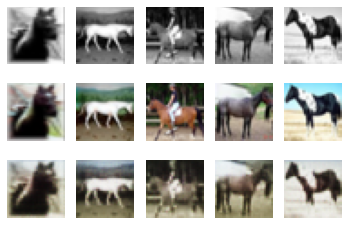

68 tensor(0.0042)
Loss:tensor(0.0042, device='cuda:0', grad_fn=<MseLossBackward0>)


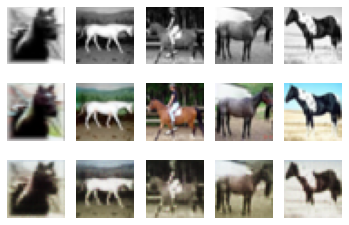

69 tensor(0.0042)
Loss:tensor(0.0042, device='cuda:0', grad_fn=<MseLossBackward0>)


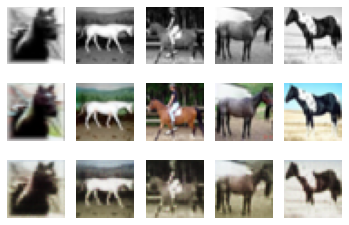

70 tensor(0.0042)
Loss:tensor(0.0042, device='cuda:0', grad_fn=<MseLossBackward0>)


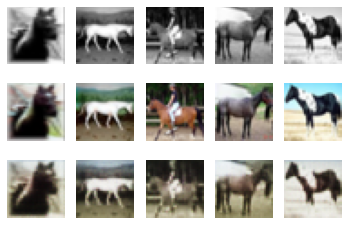

71 tensor(0.0042)
Loss:tensor(0.0042, device='cuda:0', grad_fn=<MseLossBackward0>)


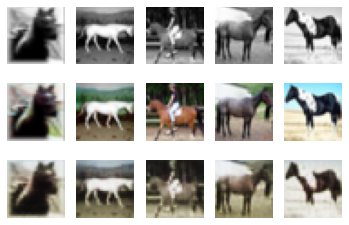

72 tensor(0.0041)
Loss:tensor(0.0041, device='cuda:0', grad_fn=<MseLossBackward0>)


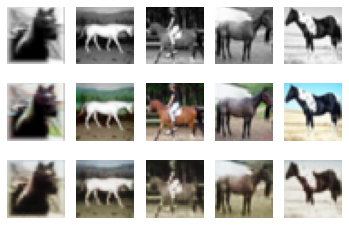

73 tensor(0.0041)
Loss:tensor(0.0041, device='cuda:0', grad_fn=<MseLossBackward0>)


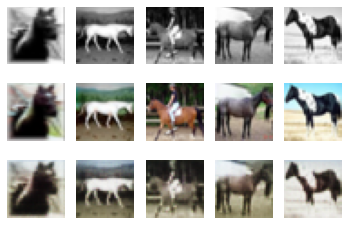

74 tensor(0.0041)
Loss:tensor(0.0041, device='cuda:0', grad_fn=<MseLossBackward0>)


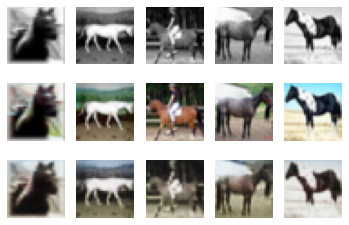

75 tensor(0.0041)
Loss:tensor(0.0041, device='cuda:0', grad_fn=<MseLossBackward0>)


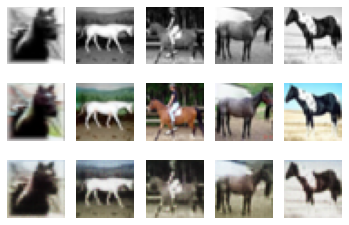

76 tensor(0.0040)
Loss:tensor(0.0040, device='cuda:0', grad_fn=<MseLossBackward0>)


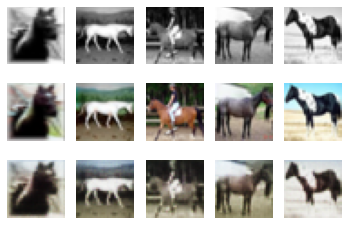

77 tensor(0.0040)
Loss:tensor(0.0040, device='cuda:0', grad_fn=<MseLossBackward0>)


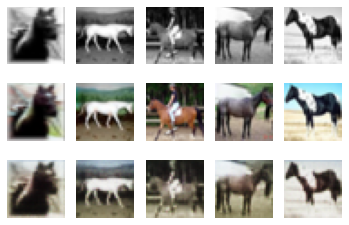

78 tensor(0.0039)
Loss:tensor(0.0039, device='cuda:0', grad_fn=<MseLossBackward0>)


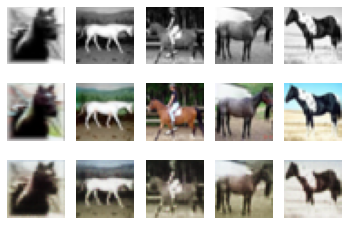

79 tensor(0.0039)
Loss:tensor(0.0039, device='cuda:0', grad_fn=<MseLossBackward0>)


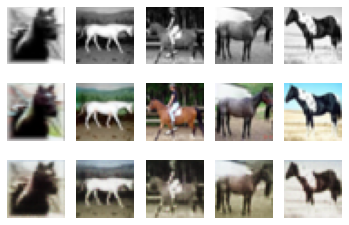

80 tensor(0.0039)
Loss:tensor(0.0039, device='cuda:0', grad_fn=<MseLossBackward0>)


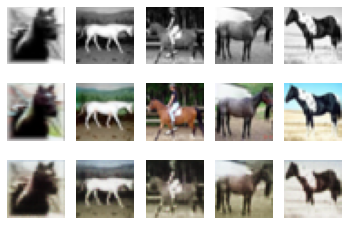

81 tensor(0.0039)
Loss:tensor(0.0039, device='cuda:0', grad_fn=<MseLossBackward0>)


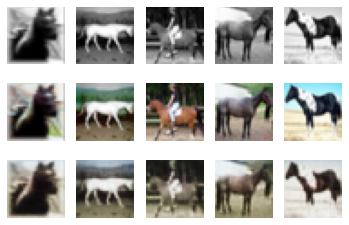

82 tensor(0.0040)
Loss:tensor(0.0040, device='cuda:0', grad_fn=<MseLossBackward0>)


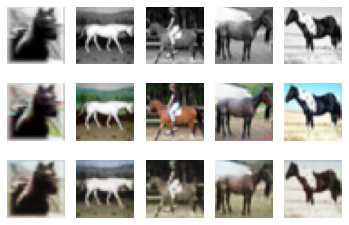

83 tensor(0.0039)
Loss:tensor(0.0039, device='cuda:0', grad_fn=<MseLossBackward0>)


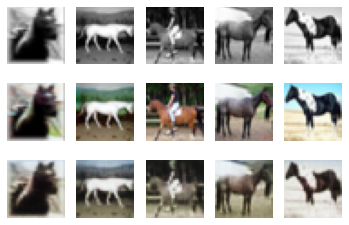

84 tensor(0.0039)
Loss:tensor(0.0039, device='cuda:0', grad_fn=<MseLossBackward0>)


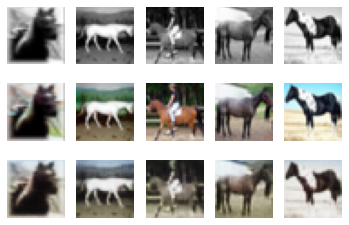

85 tensor(0.0039)
Loss:tensor(0.0039, device='cuda:0', grad_fn=<MseLossBackward0>)


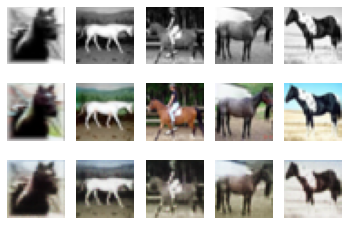

86 tensor(0.0039)
Loss:tensor(0.0039, device='cuda:0', grad_fn=<MseLossBackward0>)


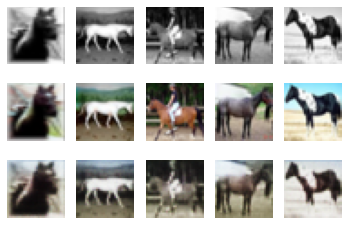

87 tensor(0.0038)
Loss:tensor(0.0038, device='cuda:0', grad_fn=<MseLossBackward0>)


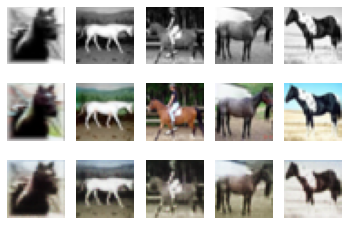

88 tensor(0.0038)
Loss:tensor(0.0038, device='cuda:0', grad_fn=<MseLossBackward0>)


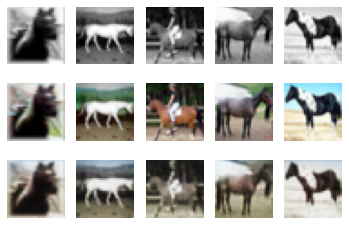

89 tensor(0.0037)
Loss:tensor(0.0037, device='cuda:0', grad_fn=<MseLossBackward0>)


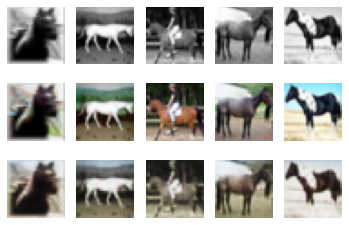

90 tensor(0.0037)
Loss:tensor(0.0037, device='cuda:0', grad_fn=<MseLossBackward0>)


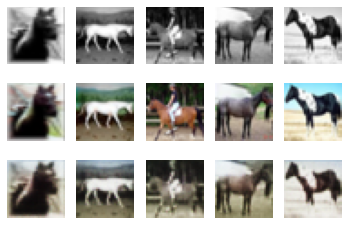

91 tensor(0.0037)
Loss:tensor(0.0037, device='cuda:0', grad_fn=<MseLossBackward0>)


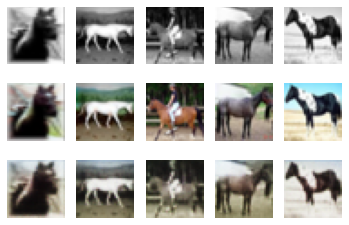

92 tensor(0.0037)
Loss:tensor(0.0037, device='cuda:0', grad_fn=<MseLossBackward0>)


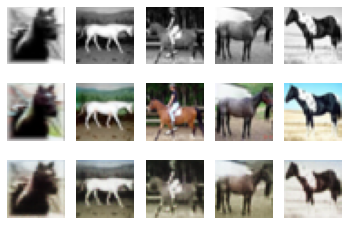

93 tensor(0.0036)
Loss:tensor(0.0036, device='cuda:0', grad_fn=<MseLossBackward0>)


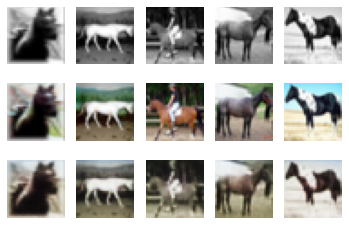

94 tensor(0.0036)
Loss:tensor(0.0036, device='cuda:0', grad_fn=<MseLossBackward0>)


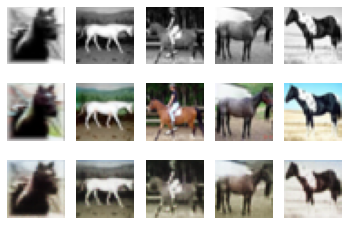

95 tensor(0.0037)
Loss:tensor(0.0037, device='cuda:0', grad_fn=<MseLossBackward0>)


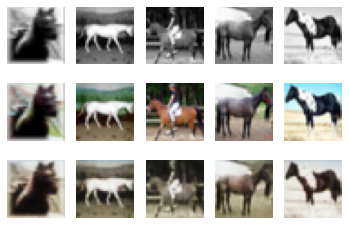

96 tensor(0.0037)
Loss:tensor(0.0037, device='cuda:0', grad_fn=<MseLossBackward0>)


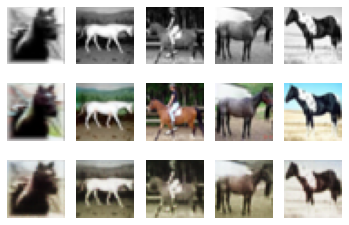

97 tensor(0.0037)
Loss:tensor(0.0037, device='cuda:0', grad_fn=<MseLossBackward0>)


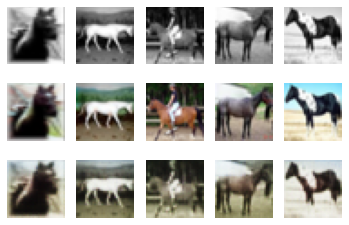

98 tensor(0.0036)
Loss:tensor(0.0036, device='cuda:0', grad_fn=<MseLossBackward0>)


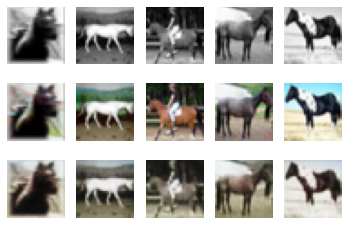

99 tensor(0.0036)
Loss:tensor(0.0036, device='cuda:0', grad_fn=<MseLossBackward0>)


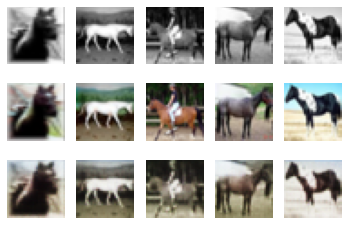

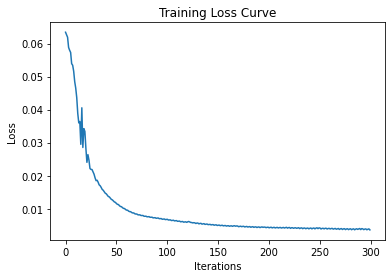

Final Loss: 0.0035821597557514906
Total time elapsed: 123.01 seconds


In [ ]:
# Main training loop for UNet
args = AttrDict()
args_dict = {
    "gpu": True,
    "valid": True,
    "checkpoint": "",
    "colours": "./data/colours/colour_kmeans24_cat7.npy",
    "model": "UNet",
    "kernel": 2,
    "num_filters": 32,
    'learn_rate':0.001, 
    "batch_size": 2000,
    "epochs": 100,
    "seed": 0,
    "plot": True,
    "experiment_name": "colourization_Unet",
    "visualize": False,
    "downsize_input": False,
}
args.update(args_dict)
cnn = train(args)

**Answer**
With a batch size as large as 2000 the rate at which the network learns has slowed down since it's updates are averaged out over 2000 images and so there is less movemeent. This also results in a higer loss of 0.003. Qulitatively also the color predictions are mostly dull brown, grey or dull green which is alos due to averaging loss over too many images.
So i think a batch size of 200 is perfect.